### This notebook merge the 3 datasets (mouse brain Cusanovich, 10x, Fang) using 1 sample per dataset and the correct 10x file with filtering eliminating any cells with less than 100 windows covered

### Merging datasets after feature space reduction.
Calculate the variance of every feature (sum of all cells covered divided by the total nb of cells), take the top ~75000 features the closest to 0.5 variance, merge, remove cells with less than 100 windows covered, linear regression on the number of windows covered. 

### Here we are looking for a better cell type ID
Once it is done, it would be great to add more datasets

In [1]:
import anndata as ad
import scanpy.api as sc
import episcanpy.api as epi
import numpy as np
import copy
import scipy
import pandas as pd
import seaborn as sns
import matplotlib as plt
import pandas as pd

/home/icb/chaichoompu/.local/lib/python3.7/site-packages/scanpy/api/__init__.py:6: FutureWarning: 

In a future version of Scanpy, `scanpy.api` will be removed.
Simply use `import scanpy as sc` and `import scanpy.external as sce` instead.

  FutureWarning


In [2]:
sc.settings.set_figure_params(dpi=80, dpi_save=400)
DATADIR="/home/icb/chaichoompu/Group/workspace/Benchmarking_data_integration/data/brain_atac_3datasets"

In [3]:
# function to calculate the variance
def cal_var(adata):
    adata.var['n_cells'] = adata.X.sum(axis=0)
    adata.var['var_cells'] = adata.X.sum(axis=0)/len(adata.obs_names.tolist())
    
    # plotting
    #fig = plt.figure(figsize=(8,6))
    #sns.distplot(adata.var['n_cells']*100, bins=40)
    sns.distplot(adata.var['var_cells'], bins=40)
    #fig.legend(labels=['n_cells','var_cells'],
    #           loc='upper right')
    #plt.show()

## Louvain clustering (I will add the proper cell type annotation later)

In [4]:
adata_merge_all = ad.read(DATADIR+"/merge_10x_CEMBA180312_3B_GSM3034638_bin_merged_top_var_feat_min100cells_regression.h5ad")


In [5]:
adata_merge_all

AnnData object with n_obs × n_vars = 19811 × 35196 
    obs: 'batch', 'batchname', 'n_counts', 'n_windows', 'sum_peaks', 'n_genes'
    var: 'chrom-0-0', 'chrom2-0-0', 'n_cells-0-0', 'var_cells-0-0', 'overlap_3datasets', 'n_cells-1-0', 'var_cells-1-0', 'overlap10x-1-0', 'first_filtering-1', 'second_filtering-1', 'n_cells-1', 'var_cells-1', 'n_cells', 'var_cells', 'commonness'
    uns: 'batchname_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [6]:
set(adata_merge_all.obs['batchname'])

{'10x Genomics', 'Fang et al. 2019', 'GSM3034638'}

In [7]:
adata_10x = adata_merge_all[adata_merge_all.obs['batchname']== '10x Genomics',:]
adata_Fang = adata_merge_all[adata_merge_all.obs['batchname']== 'Fang et al. 2019',:]
adata_Cus = adata_merge_all[adata_merge_all.obs['batchname']== 'GSM3034638',:]

# Cell type ID for adata_10x

In [8]:
adata_10x

View of AnnData object with n_obs × n_vars = 4345 × 35196 
    obs: 'batch', 'batchname', 'n_counts', 'n_windows', 'sum_peaks', 'n_genes'
    var: 'chrom-0-0', 'chrom2-0-0', 'n_cells-0-0', 'var_cells-0-0', 'overlap_3datasets', 'n_cells-1-0', 'var_cells-1-0', 'overlap10x-1-0', 'first_filtering-1', 'second_filtering-1', 'n_cells-1', 'var_cells-1', 'n_cells', 'var_cells', 'commonness'
    uns: 'batchname_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [9]:
sc.pp.pca(adata_10x)
sc.pp.neighbors(adata_10x, method='gauss')
sc.tl.umap(adata_10x)
sc.tl.tsne(adata_10x)

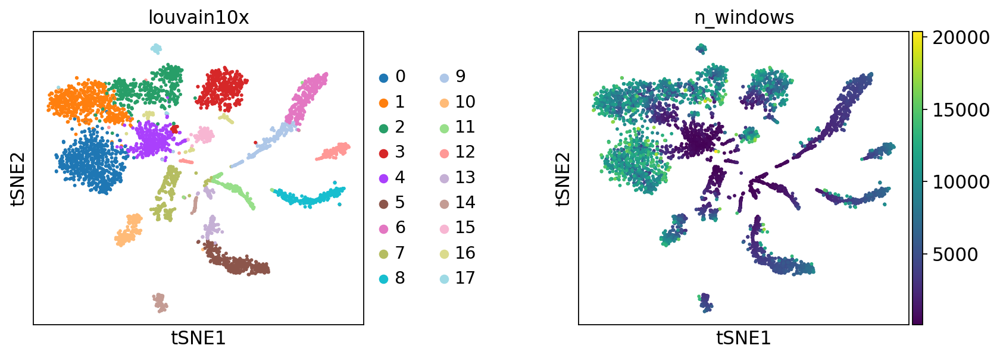

In [14]:
# Not taking this resolution
#sc.tl.louvain(adata_10x, resolution=1, key_added='louvain10x')
#sc.pl.pca(adata_10x, wspace=0.5, color=['louvain10x','n_windows'])
#sc.pl.tsne(adata_10x, wspace=0.5, color=['louvain10x', 'n_windows'])
#sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x', 'n_windows'])

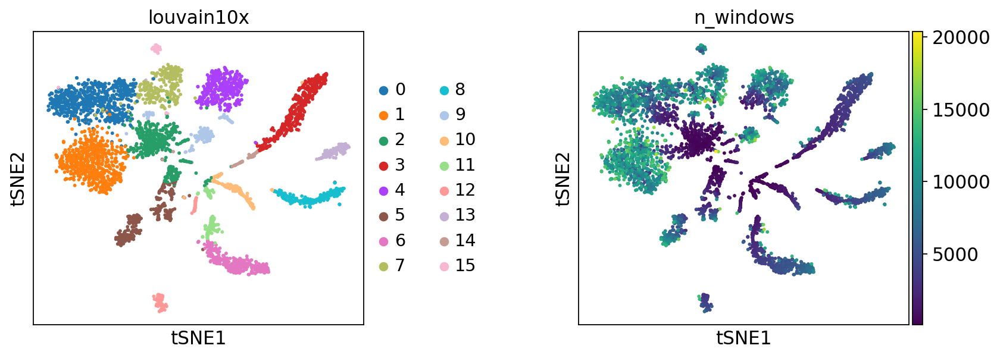

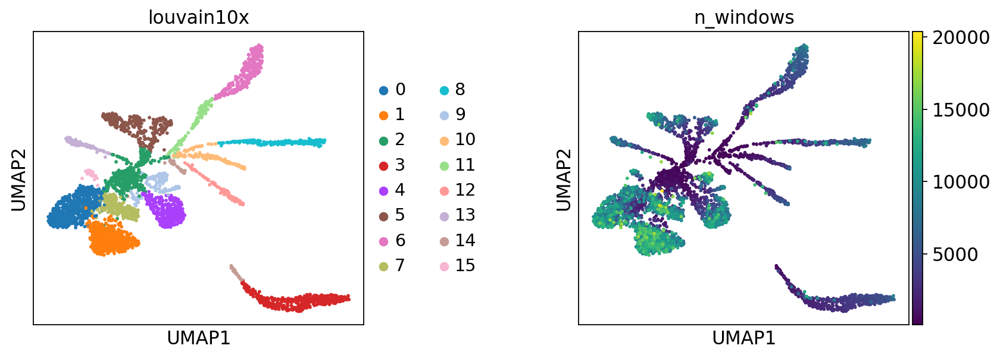

In [16]:
# I will take this resolution
sc.tl.louvain(adata_10x, resolution=0.5, key_added='louvain10x')
#sc.pl.pca(adata_10x, wspace=0.5, color=['louvain10x','n_windows'])
sc.pl.tsne(adata_10x, wspace=0.5, color=['louvain10x', 'n_windows'])
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x', 'n_windows'])

... storing 'louvain10x2' as categorical


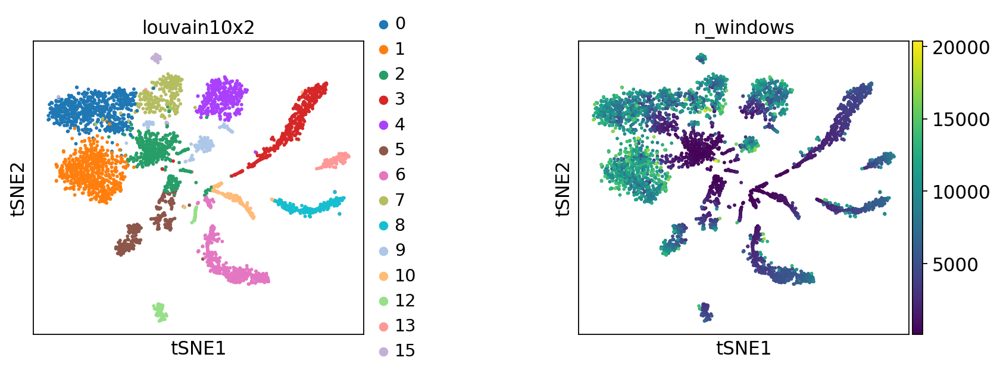

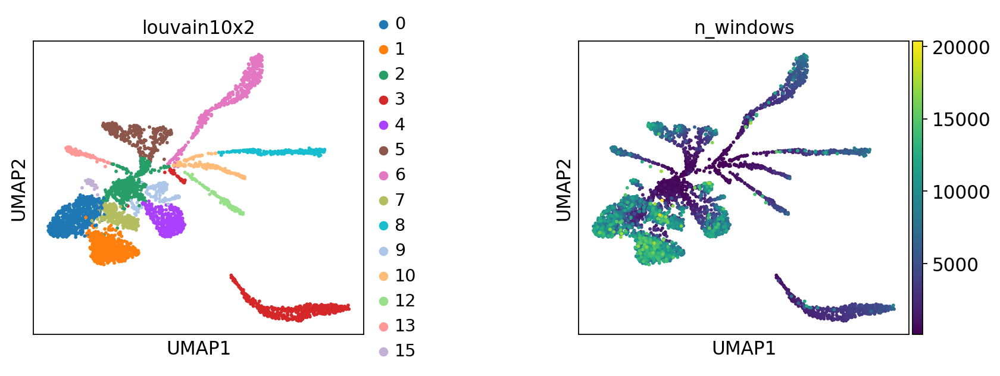

In [48]:
# merging clusters that correspond to the same cell type but are divided by louvain due to coverage differences
annot = []
for n in adata_10x.obs['louvain10x']:
    if n in ['14', '3']:
        annot.append('3')
    elif n in ['6', '11']:
        annot.append('6')
    else:
        annot.append(n)
        
adata_10x.obs['louvain10x2'] = annot
sc.pl.tsne(adata_10x, wspace=0.5, color=['louvain10x2', 'n_windows'])
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x2', 'n_windows'])

In [37]:
## What in cluster 3:
sc.tl.rank_genes_groups(adata_10x, 'louvain10x2')
top_windows_3 = [n.tolist()[3] for n in adata_10x.uns['rank_genes_groups']['names']]
top_windows_3_bis = []
for m in [n.split('_') for n in top_windows_3]:
    m[0] = m[0][3:]
    bis = ':'.join([m[0], m[1]])
    bis = '-'.join([bis, m[-1]])
    top_windows_3_bis.append(bis)

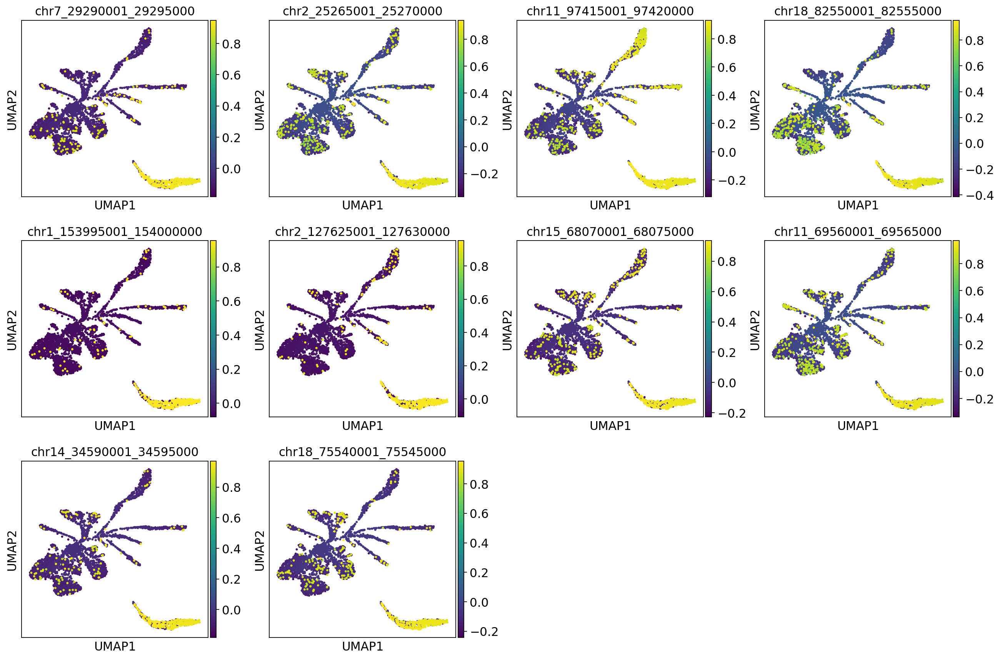

['7:29290001-29295000', '2:25265001-25270000', '11:97415001-97420000', '18:82550001-82555000', '1:153995001-154000000', '2:127625001-127630000', '15:68070001-68075000', '11:69560001-69565000', '14:34590001-34595000', '18:75540001-75545000']


In [47]:
sc.pl.umap(adata_10x, color=top_windows_3[0:10])
print(top_windows_3_bis[0:10])

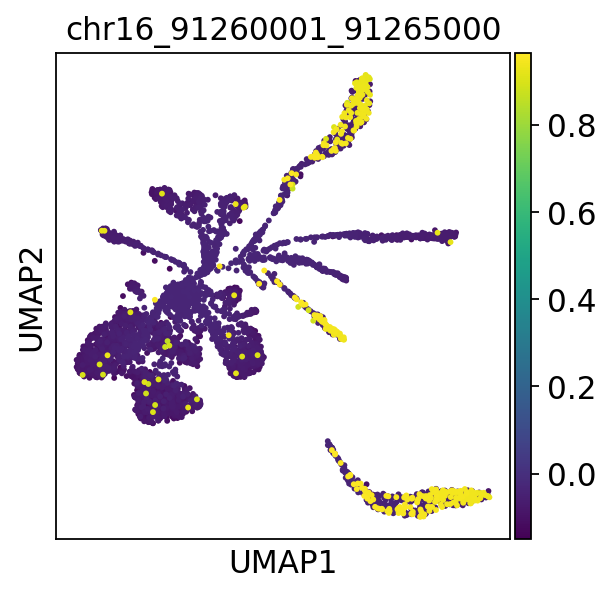

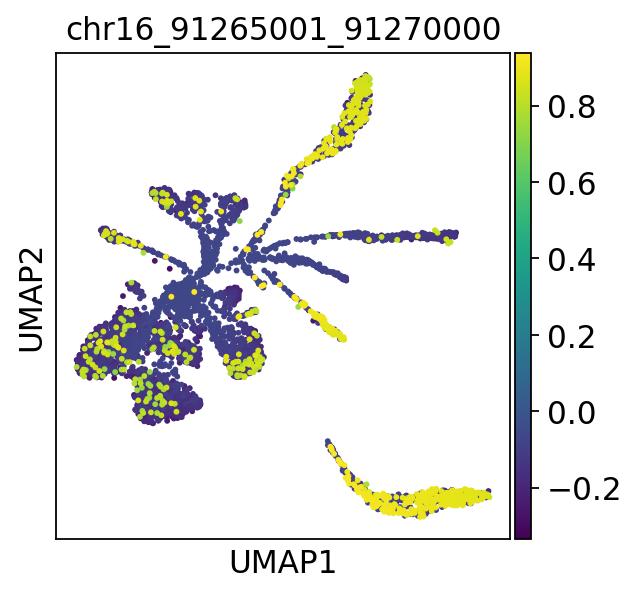

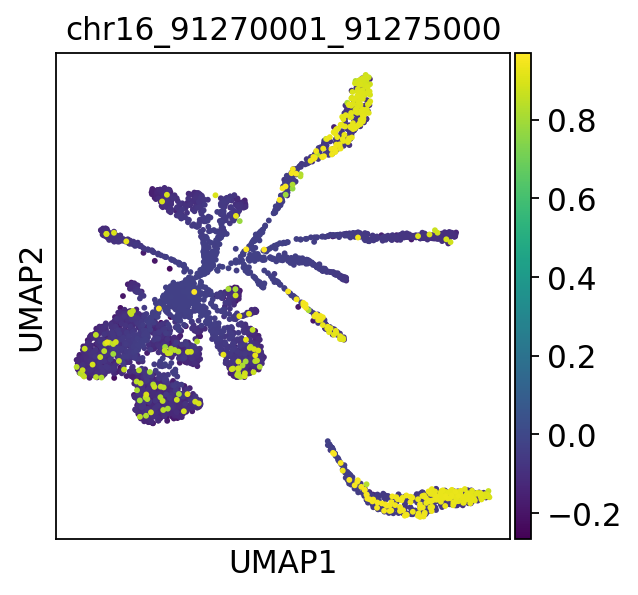

In [64]:
# Olig1 is a canonical marker of oligodendrocytes - 16: 91,269,772-91,271,933
for n in [['chr16', '91260001', '91265000'],
['chr16', '91265001', '91270000'],
['chr16', '91270001', '91275000']]:
    n = "_".join(n)
    sc.pl.umap(adata_10x, color=n)

In [ ]:
adata_10x[0]

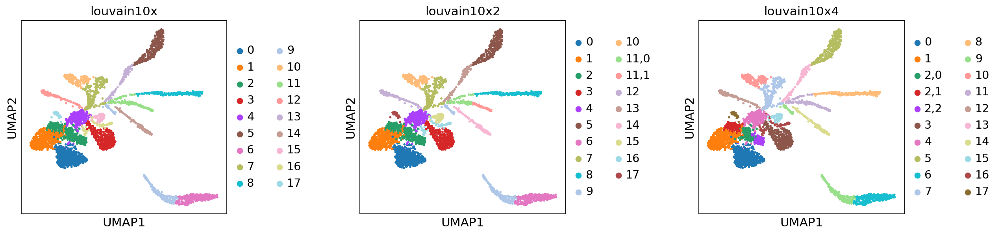

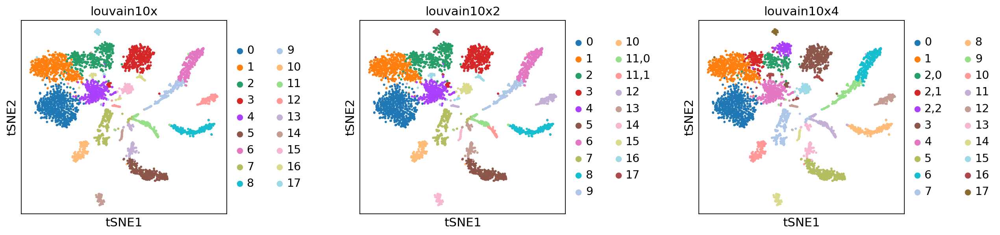

In [13]:
sc.tl.louvain(adata_10x, resolution=0.5, key_added='louvain10x4', restrict_to=['louvain10x', ['2']])
#sc.tl.louvain(adata_10x, resolution=0.4, key_added='louvain10x3', restrict_to=['louvain10x2', ['11,0']])
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x', 'louvain10x2', 'louvain10x4'])
sc.pl.tsne(adata_10x, wspace=0.5, color=['louvain10x', 'louvain10x2', 'louvain10x4'])

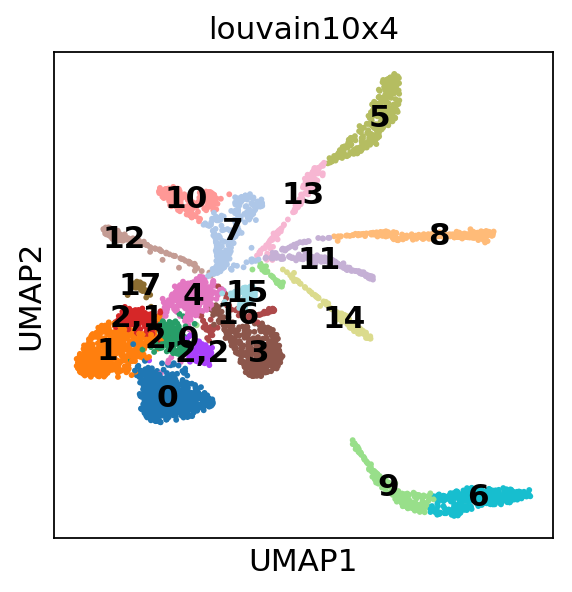

In [14]:
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x4'], legend_loc='on data')

... storing 'louvain10x_celltype' as categorical


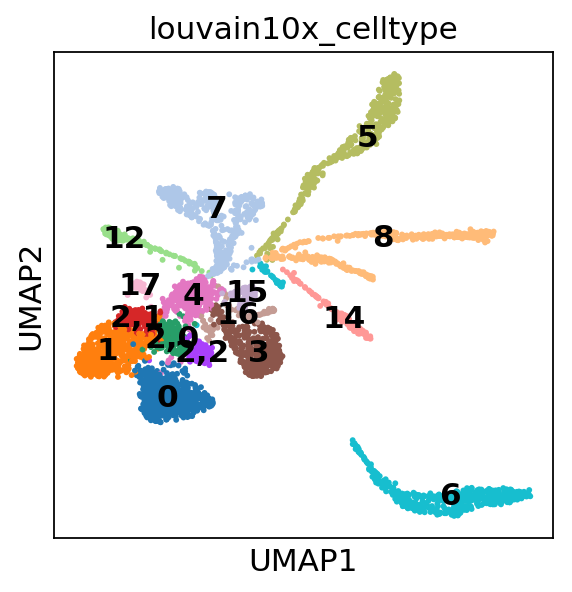

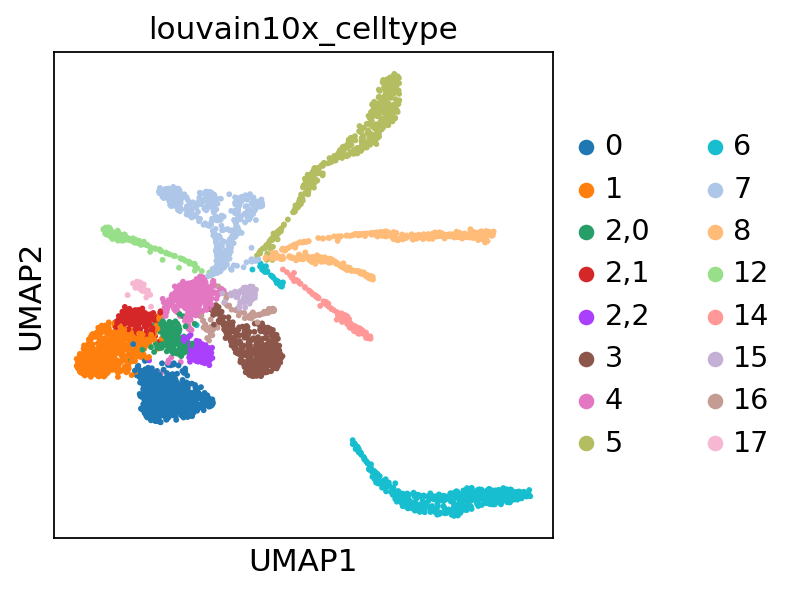

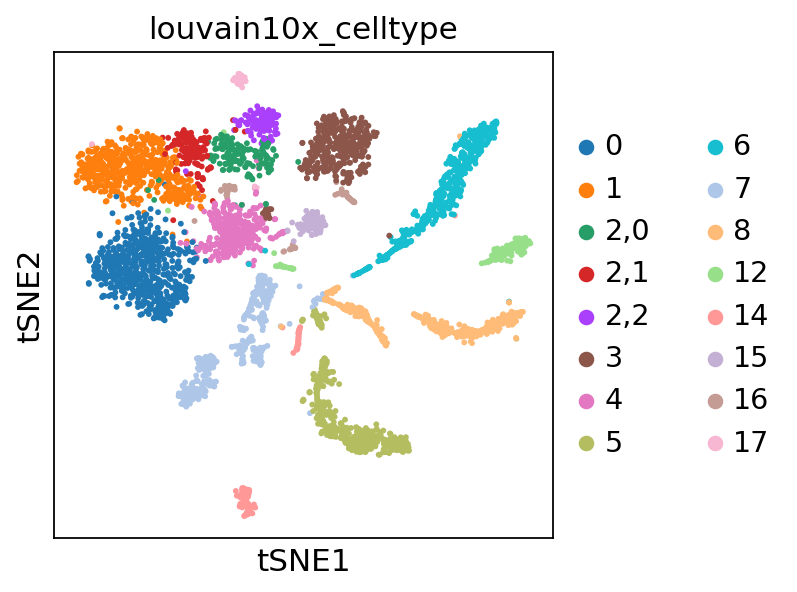

In [15]:
annot = []
for n in adata_10x.obs['louvain10x4']:
    if n in ['13', '5']:
        annot.append('5')
    elif n in ['6', '9']:
        annot.append('6')
    elif n in ['10', '7']:
        annot.append('7')
    elif n in ['11', '8']:
        annot.append('8')
    else:
        annot.append(n)
        
adata_10x.obs['louvain10x_celltype'] = annot
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x_celltype'], legend_loc='on data')
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x_celltype'])
sc.pl.tsne(adata_10x, wspace=0.5, color=['louvain10x_celltype'])

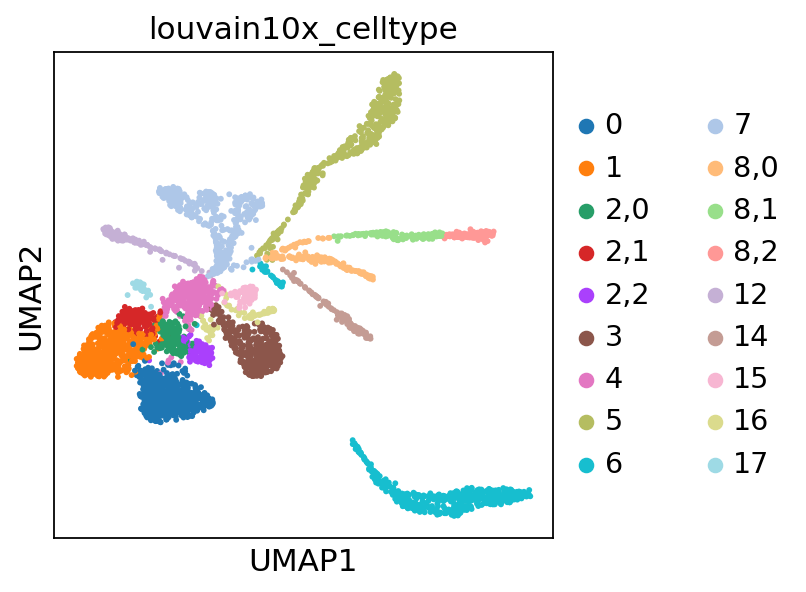

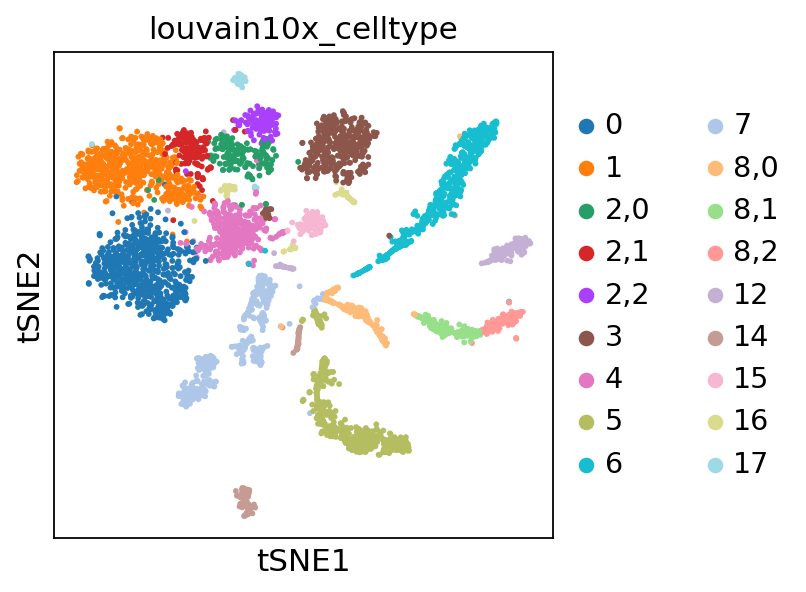

In [16]:
sc.tl.louvain(adata_10x, resolution=0.2, key_added='louvain10x_celltype', restrict_to=['louvain10x_celltype', ['8']])
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x_celltype'])
sc.pl.tsne(adata_10x, wspace=0.5, color=['louvain10x_celltype'])

... storing 'louvain10x_celltype' as categorical


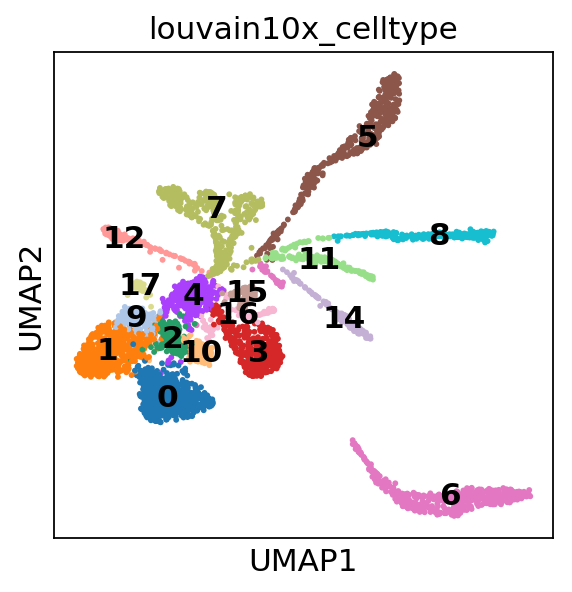

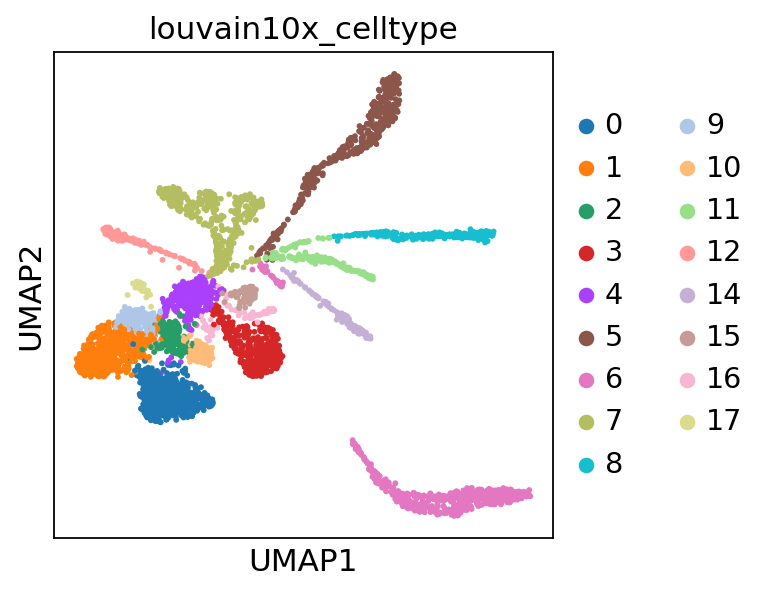

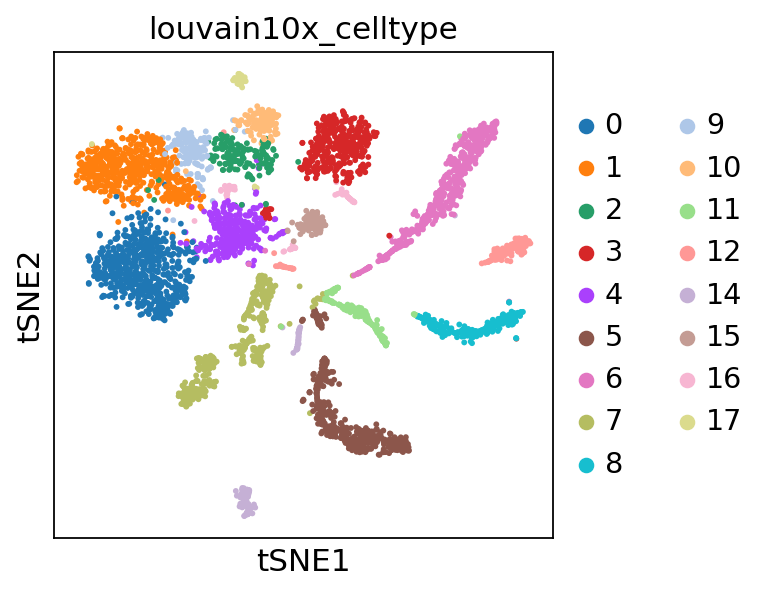

In [17]:
annot = []
for n in adata_10x.obs['louvain10x_celltype']:
    if n in ['8,1', '8,2']:
        annot.append('8')
    elif n in ['2,0']:
        annot.append('2')
    elif n in ['2,1']:
        annot.append('9')
    elif n in ['2,2']:
        annot.append('10')
    elif n in ['8,0']:
        annot.append('11')
    else:
        annot.append(n)
        
adata_10x.obs['louvain10x_celltype'] = annot
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x_celltype'], legend_loc='on data')
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x_celltype'])
sc.pl.tsne(adata_10x, wspace=0.5, color=['louvain10x_celltype'])

In [18]:
adata_10x

AnnData object with n_obs × n_vars = 4345 × 35196 
    obs: 'batch', 'batchname', 'n_counts', 'n_windows', 'sum_peaks', 'n_genes', 'louvain10x', 'louvain10x2', 'louvain10x3', 'louvain10x4', 'louvain10x_celltype'
    var: 'chrom-0-0', 'chrom2-0-0', 'n_cells-0-0', 'var_cells-0-0', 'overlap_3datasets', 'n_cells-1-0', 'var_cells-1-0', 'overlap10x-1-0', 'first_filtering-1', 'second_filtering-1', 'n_cells-1', 'var_cells-1', 'n_cells', 'var_cells', 'commonness'
    uns: 'batchname_colors', 'neighbors', 'pca', 'louvain', 'louvain10x_colors', 'louvain10x2_colors', 'louvain10x3_colors', 'louvain10x4_colors', 'louvain10x_celltype_colors'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

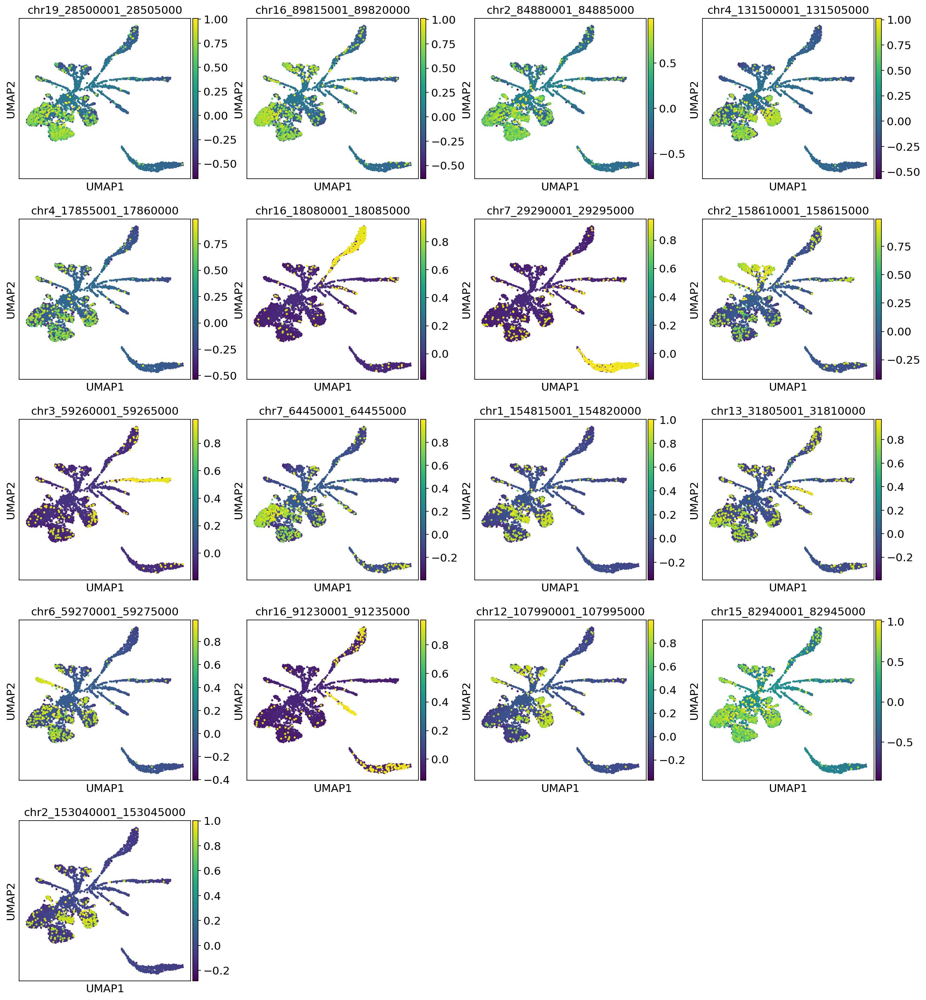

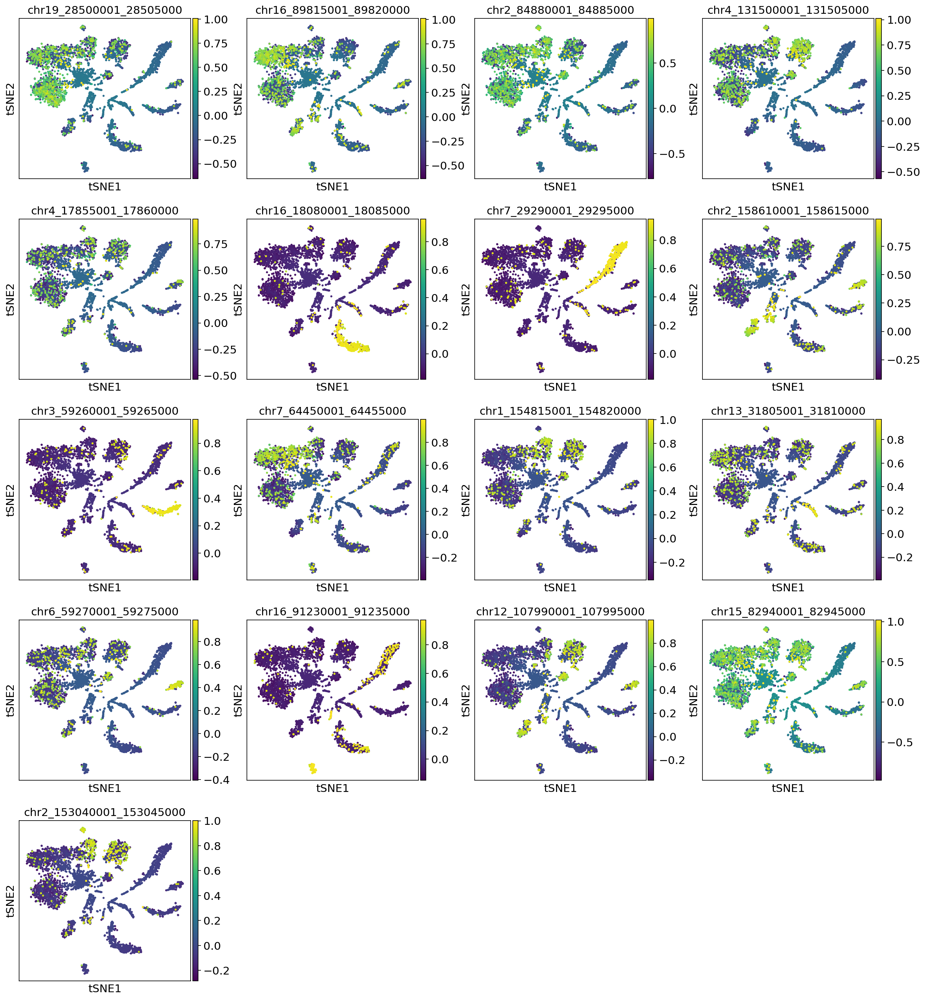

In [19]:
sc.tl.rank_genes_groups(adata_10x, 'louvain10x_celltype')
#sc.pl.rank_genes_groups(adata_10x, 'louvain10x_celltype')
top_windows = adata_10x.uns['rank_genes_groups']['names'][0].tolist()
sc.pl.umap(adata_10x, color=top_windows)
sc.pl.tsne(adata_10x, color=top_windows)

chr16_18080001_18085000


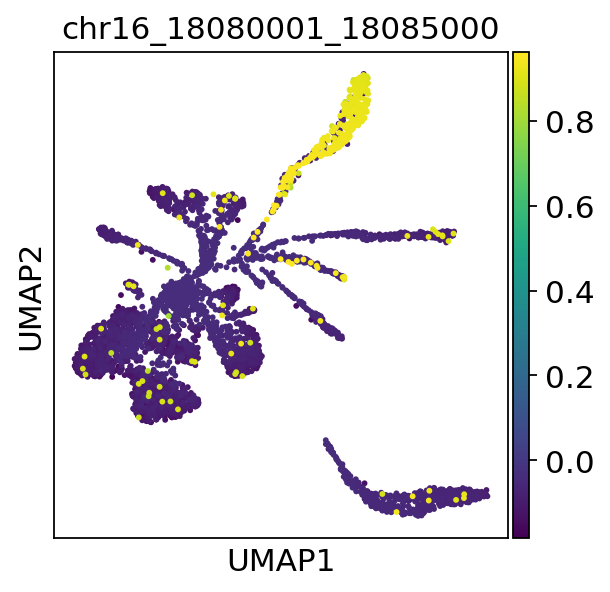

chr7_29290001_29295000


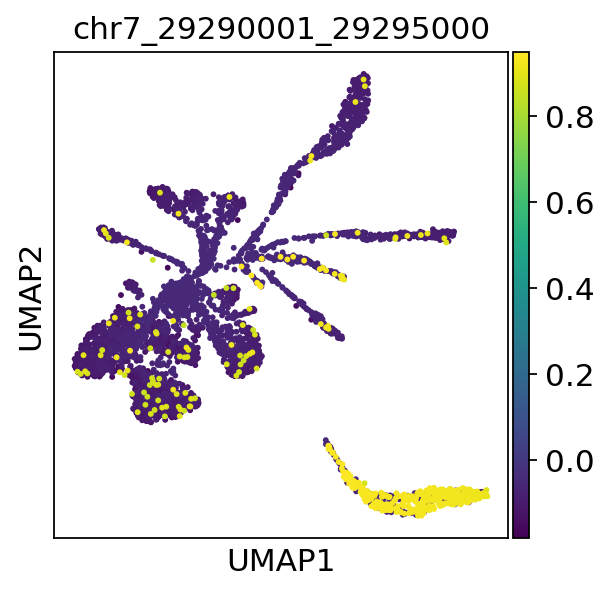

In [20]:
top_windows = adata_10x.uns['rank_genes_groups']['names'][0].tolist()
marker = top_windows[5]
print(marker)
sc.pl.umap(adata_10x, color=marker)
marker = top_windows[6]
print(marker)
sc.pl.umap(adata_10x, color=marker)

chr1_182480001_182485000


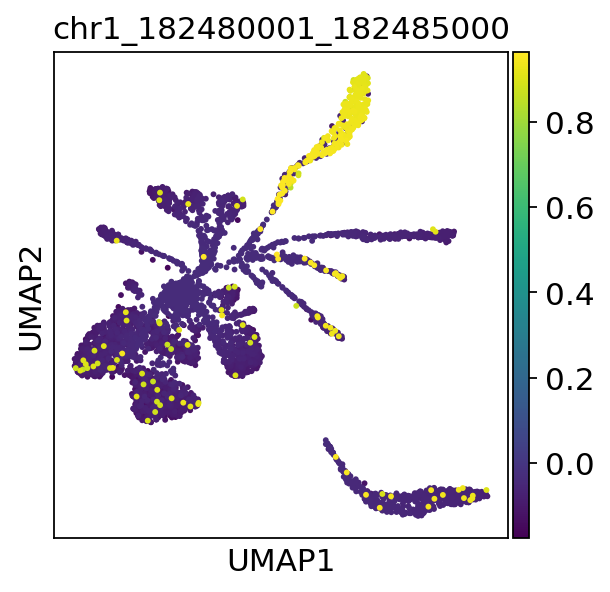

chr2_25265001_25270000


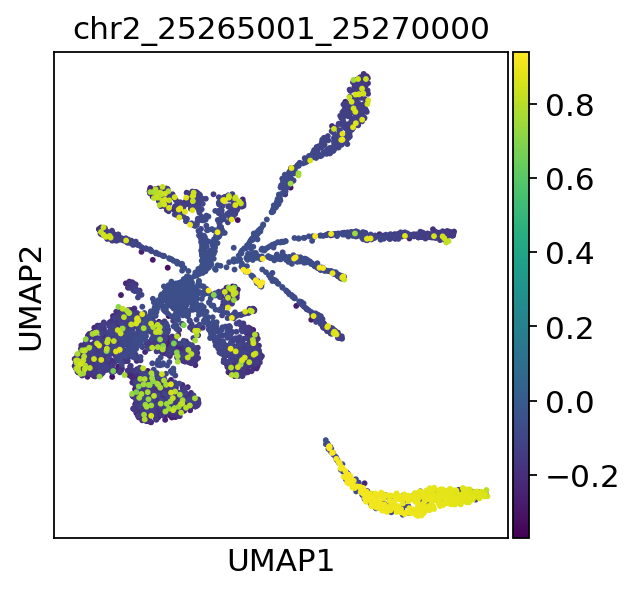

In [21]:
top_windows = adata_10x.uns['rank_genes_groups']['names'][1].tolist()
marker = top_windows[5]
print(marker)
sc.pl.umap(adata_10x, color=marker)
marker = top_windows[6]
print(marker)
sc.pl.umap(adata_10x, color=marker)

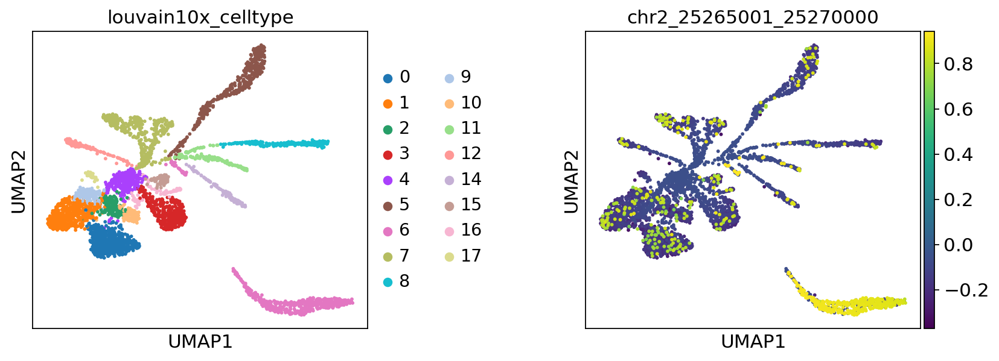

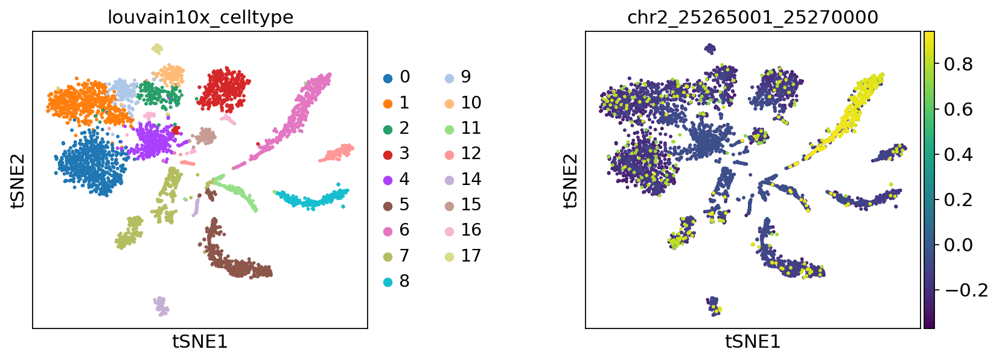

In [22]:
sc.pl.umap(adata_10x, wspace=0.5, color=['louvain10x_celltype', marker])
sc.pl.tsne(adata_10x, wspace=0.5, color=['louvain10x_celltype', marker])

... storing 'celltype10x' as categorical


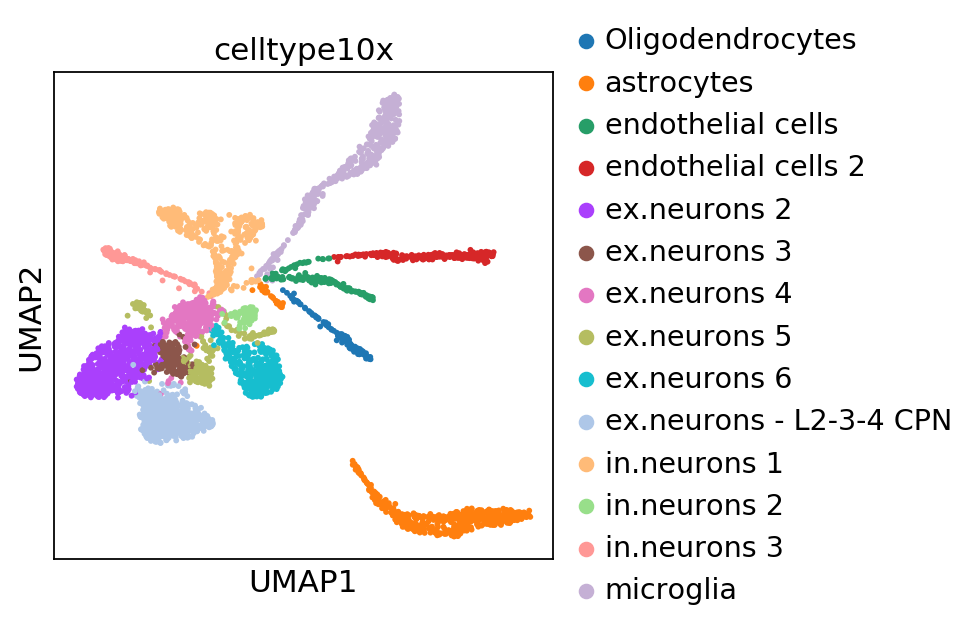

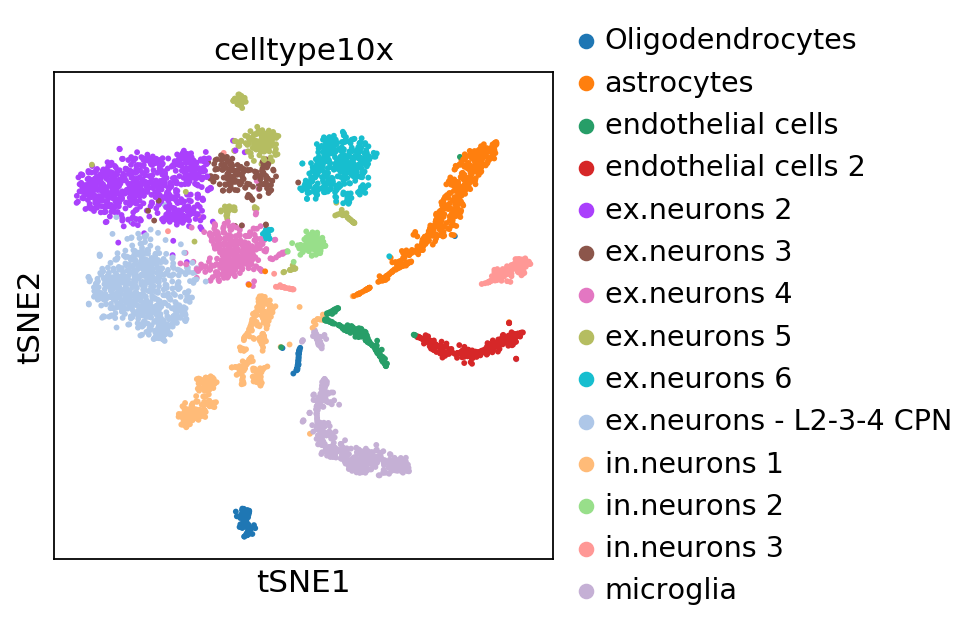

In [23]:
annot = []
for n in adata_10x.obs['louvain10x_celltype']:
    if n in ['0']:
        annot.append('ex.neurons - L2-3-4 CPN')
    elif n in ['1', '9']:
        annot.append('ex.neurons 2')
    elif n in ['2']:
        annot.append('ex.neurons 3')
    elif n in ['3']:
        annot.append('ex.neurons 6')
    elif n in ['4']:
        annot.append('ex.neurons 4')
    elif n in ['5']:
        annot.append('microglia')
    elif n in ['6']:
        annot.append('astrocytes')
    elif n in ['7']:
        annot.append('in.neurons 1')
    elif n in ['12']:
        annot.append('in.neurons 3')
    elif n in ['11']:
        annot.append('endothelial cells')
    elif n in ['8']:
        annot.append('endothelial cells 2')
    elif n in ['17', '16', '10']:
        annot.append('ex.neurons 5')
    elif n in ['14']:
        annot.append('Oligodendrocytes')
    elif n in ['15']:
        annot.append('in.neurons 2')
    else:
        annot.append(n)
    
adata_10x.obs['celltype10x'] = annot

sc.pl.umap(adata_10x, wspace=0.5, color=['celltype10x'])
sc.pl.tsne(adata_10x, wspace=0.5, color=['celltype10x'])

### adata_Fang

In [24]:
adata_Fang

View of AnnData object with n_obs × n_vars = 12086 × 35196 
    obs: 'batch', 'batchname', 'n_counts', 'n_windows', 'sum_peaks', 'n_genes'
    var: 'chrom-0-0', 'chrom2-0-0', 'n_cells-0-0', 'var_cells-0-0', 'overlap_3datasets', 'n_cells-1-0', 'var_cells-1-0', 'overlap10x-1-0', 'first_filtering-1', 'second_filtering-1', 'n_cells-1', 'var_cells-1', 'n_cells', 'var_cells', 'commonness'
    uns: 'batchname_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [25]:
sc.pp.pca(adata_Fang)
sc.pp.neighbors(adata_Fang, method='gauss')
sc.tl.umap(adata_Fang)
sc.tl.tsne(adata_Fang)

The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../../../home/icb/chaichoompu/.local/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../../../home/icb/chaichoompu/.local/lib/python3.7/site-packages/umap/utils.py", line 409:
@numba.njit(parallel=True)
def build_candidates(current_graph, n_vertices, n_neighbors, max_candidates, rng_state):
^

The keyword argum

In [26]:
sc.tl.louvain(adata_Fang, resolution=1, key_added='louvainFang')

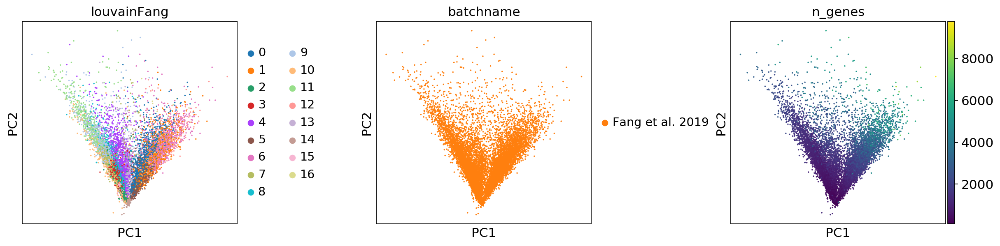

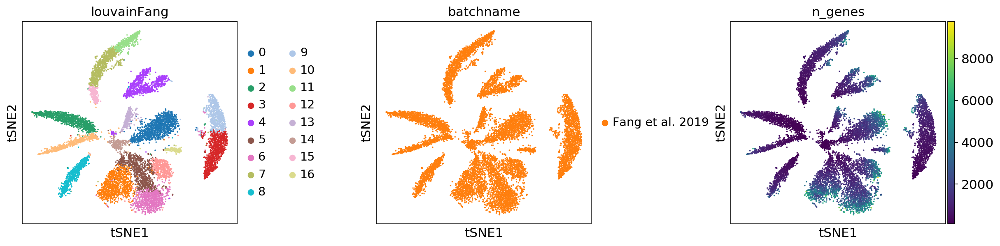

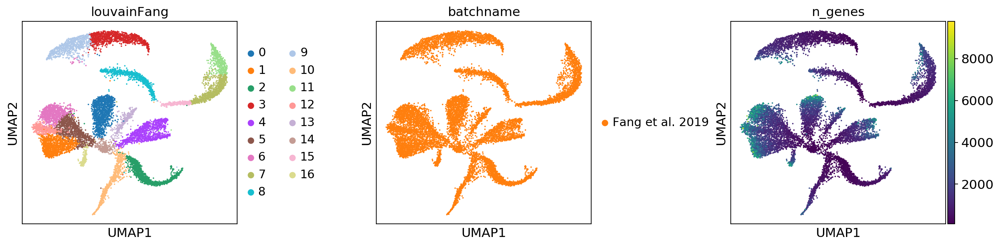

In [27]:
sc.pl.pca(adata_Fang, wspace=0.5, color=['louvainFang', 'batchname', 'n_genes'])
sc.pl.tsne(adata_Fang, wspace=0.5, color=['louvainFang', 'batchname', 'n_genes'])
sc.pl.umap(adata_Fang, wspace=0.5, color=['louvainFang', 'batchname', 'n_genes'])

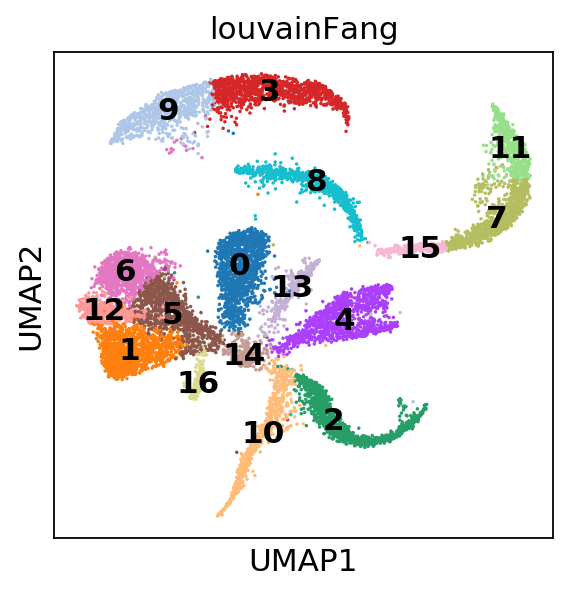

In [28]:
sc.pl.umap(adata_Fang, wspace=0.5, color=['louvainFang'], legend_loc='on data')

... storing 'louvainFang_celltype' as categorical


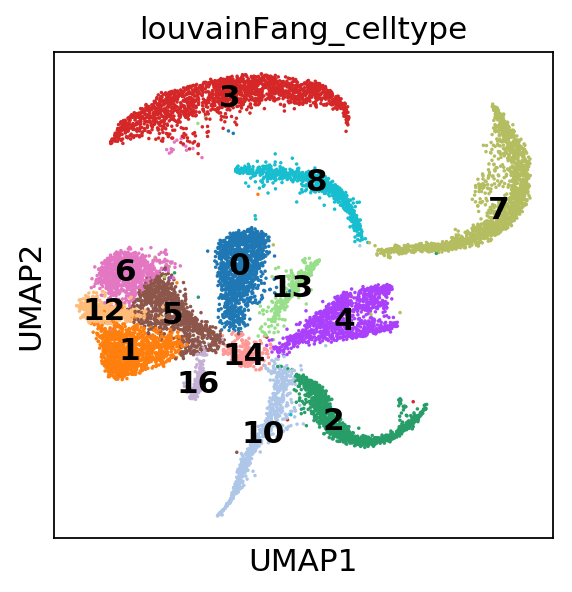

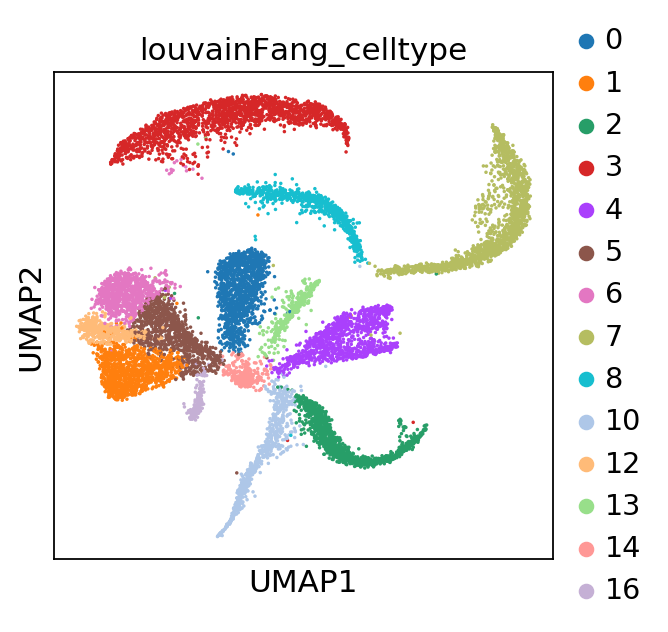

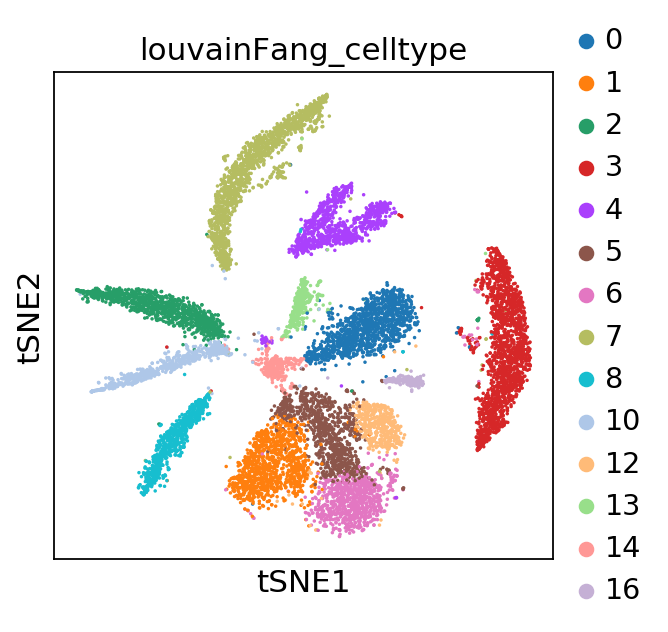

In [29]:
annot = []
for n in adata_Fang.obs['louvainFang']:
    if n in ['15', '7', '11']:
        annot.append('7')
    elif n in ['3', '9']:
        annot.append('3')
    else:
        annot.append(n)
        
adata_Fang.obs['louvainFang_celltype'] = annot
sc.pl.umap(adata_Fang, wspace=0.5, color=['louvainFang_celltype'], legend_loc='on data')
sc.pl.umap(adata_Fang, wspace=0.5, color=['louvainFang_celltype'])
sc.pl.tsne(adata_Fang, wspace=0.5, color=['louvainFang_celltype'])

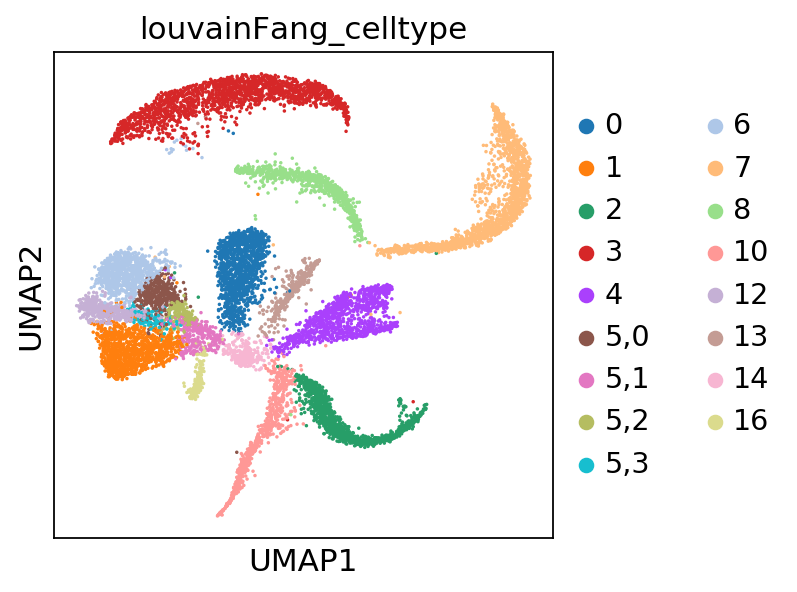

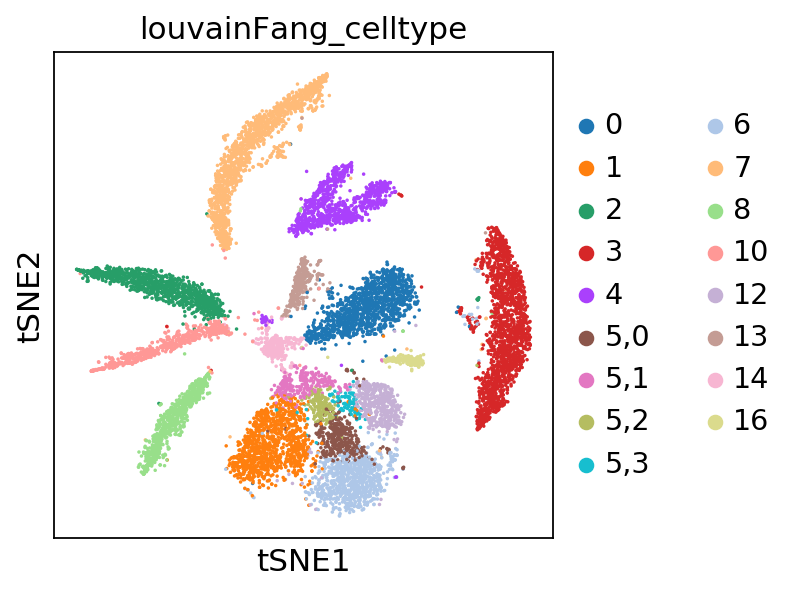

In [30]:
sc.tl.louvain(adata_Fang, resolution=0.5, restrict_to=['louvainFang_celltype', ['5']], key_added='louvainFang_celltype')
sc.pl.umap(adata_Fang, wspace=0.5, color=['louvainFang_celltype'])
sc.pl.tsne(adata_Fang, wspace=0.5, color=['louvainFang_celltype'])

... storing 'louvainFang_celltype2' as categorical


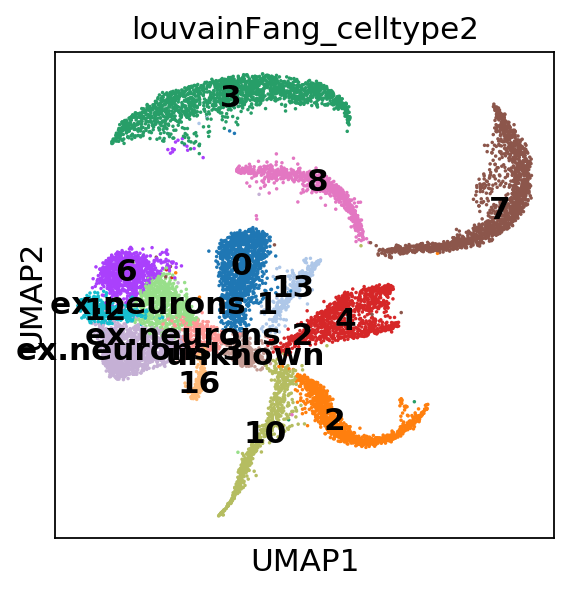

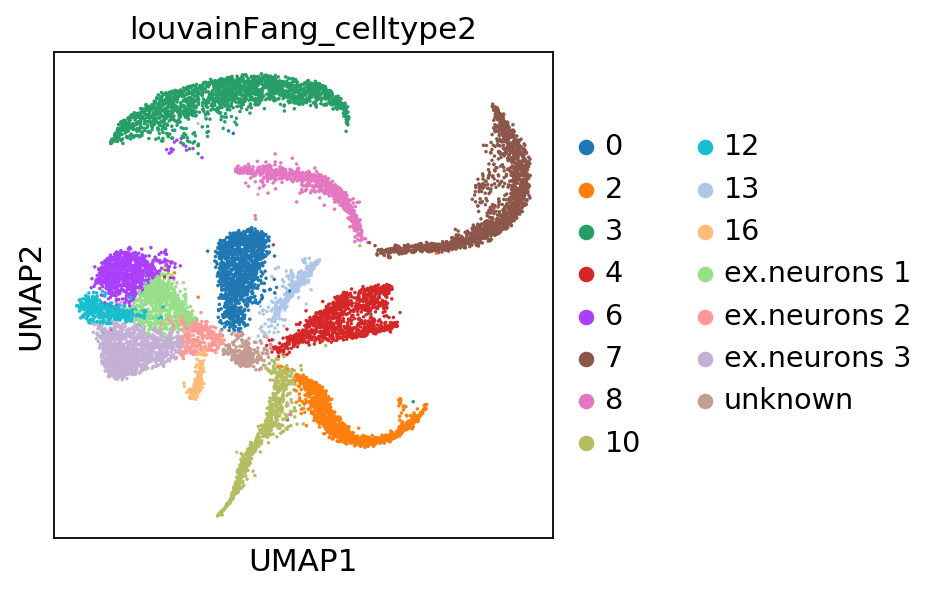

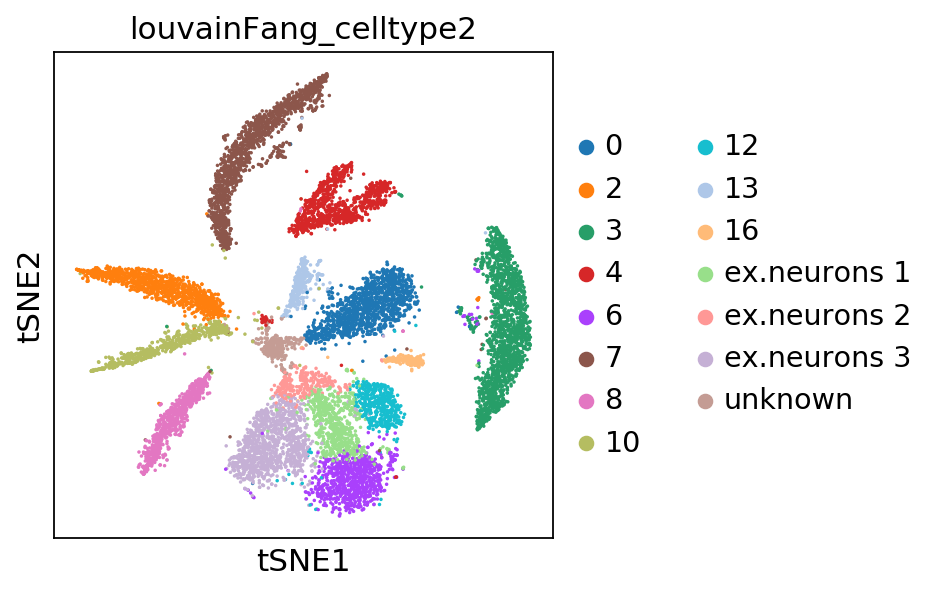

In [31]:
annot = []
for n in adata_Fang.obs['louvainFang_celltype']:
    if n in ['5,0', '5,2', '5,3']:
        annot.append('ex.neurons 1')
    elif n in ['5,1']:
        annot.append('ex.neurons 2')
    elif n in ['1']:
        annot.append('ex.neurons 3')
    elif n in ['12, 5,3']:
        annot.append('ex.4')
    elif n in ['14']:
        annot.append('unknown')
    else:
        annot.append(n)
        
adata_Fang.obs['louvainFang_celltype2'] = annot
sc.pl.umap(adata_Fang, wspace=0.5, color=['louvainFang_celltype2'], legend_loc='on data')
sc.pl.umap(adata_Fang, wspace=0.5, color=['louvainFang_celltype2'])
sc.pl.tsne(adata_Fang, wspace=0.5, color=['louvainFang_celltype2'])

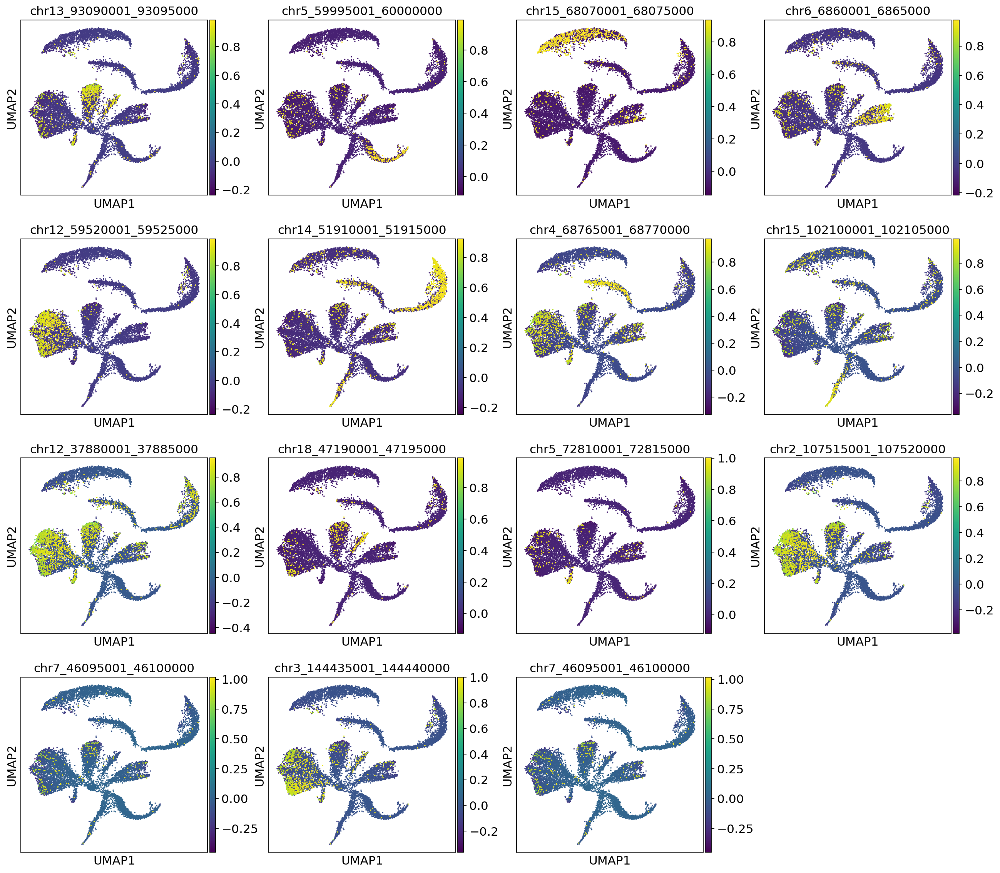

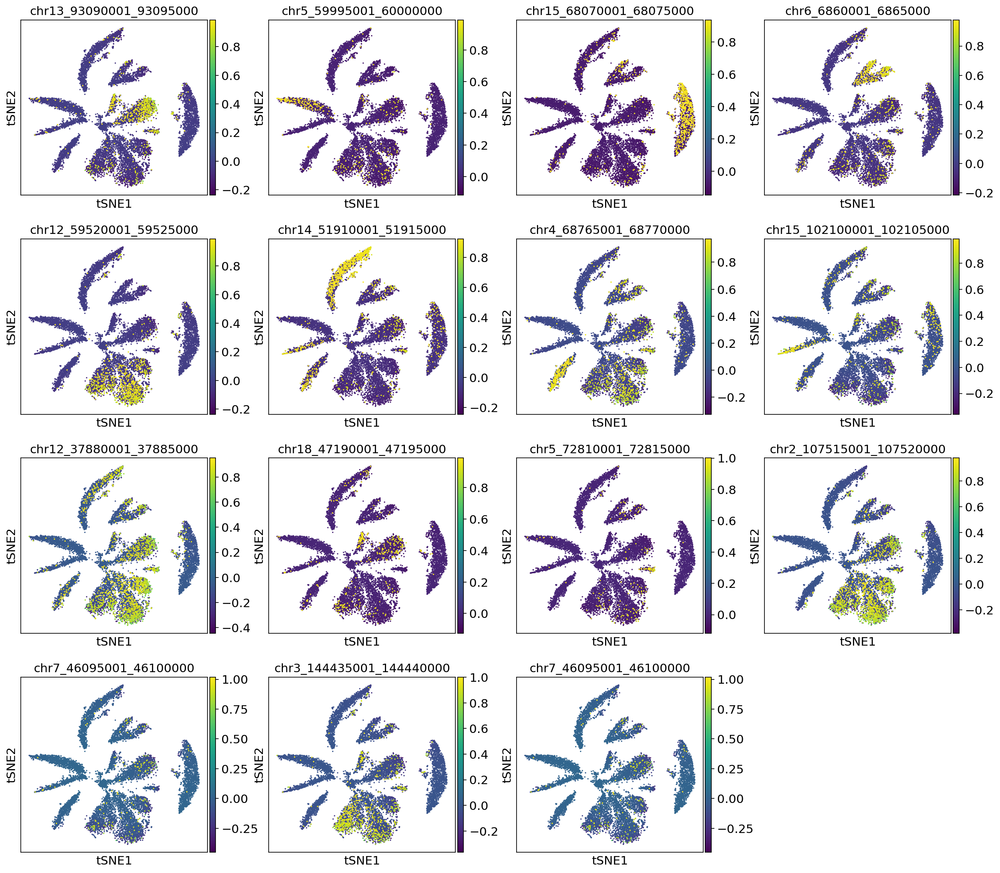

In [32]:
sc.tl.rank_genes_groups(adata_Fang, 'louvainFang_celltype2')
top_windows = adata_Fang.uns['rank_genes_groups']['names'][0].tolist()
sc.pl.umap(adata_Fang, color=top_windows)
sc.pl.tsne(adata_Fang, color=top_windows)

In [33]:
marker = top_windows[10]
print(marker)

chr5_72810001_72815000


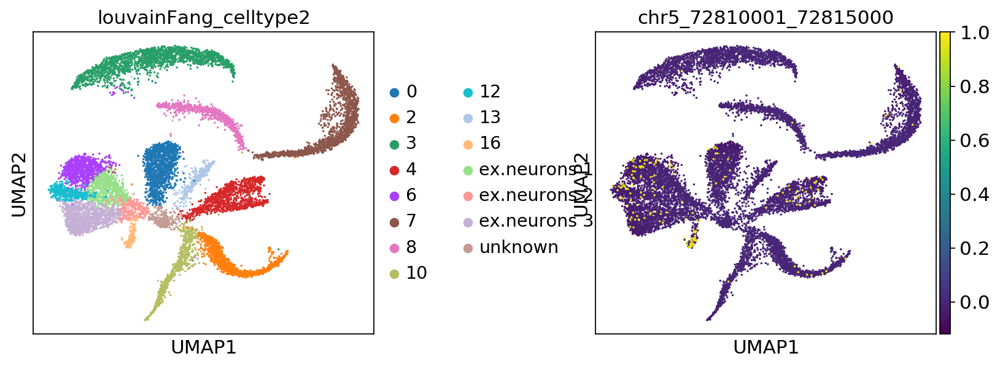

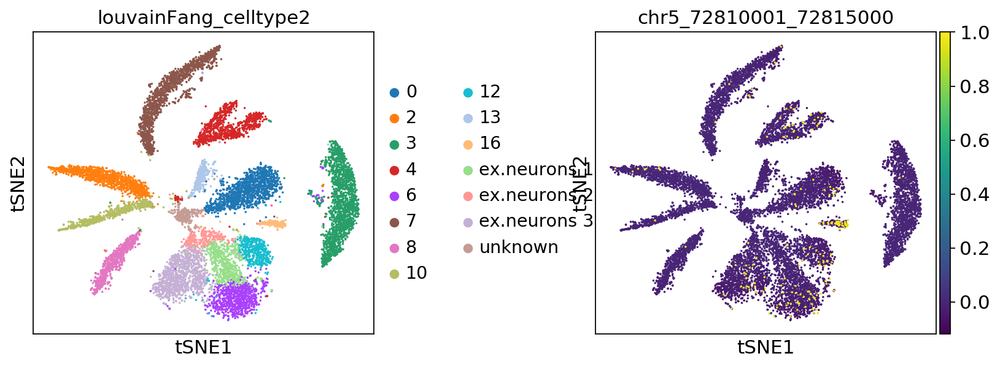

In [34]:
sc.pl.umap(adata_Fang, wspace=0.5, color=['louvainFang_celltype2', marker])
sc.pl.tsne(adata_Fang, wspace=0.5, color=['louvainFang_celltype2', marker])

... storing 'celltypeFang' as categorical


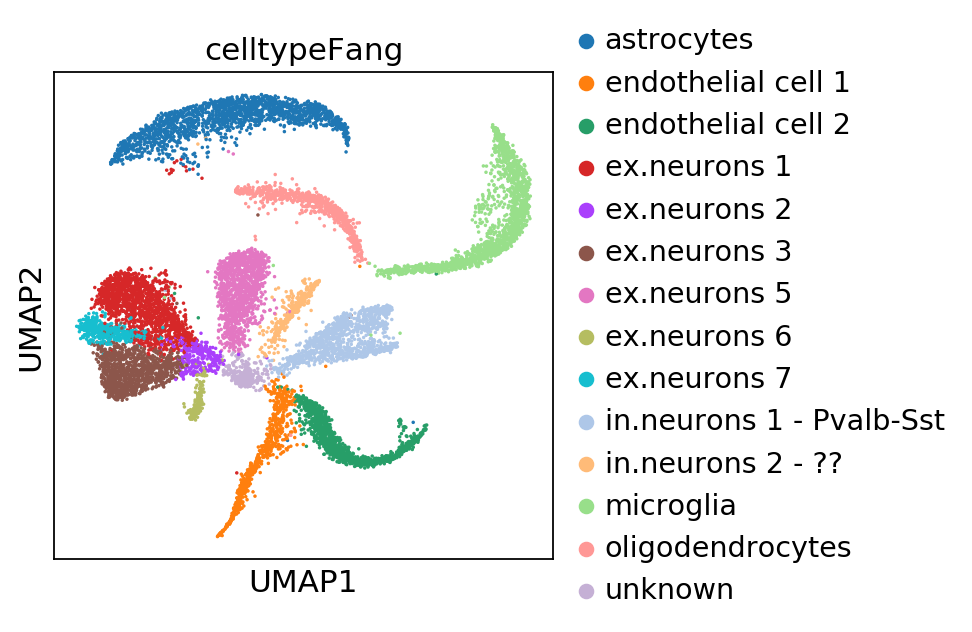

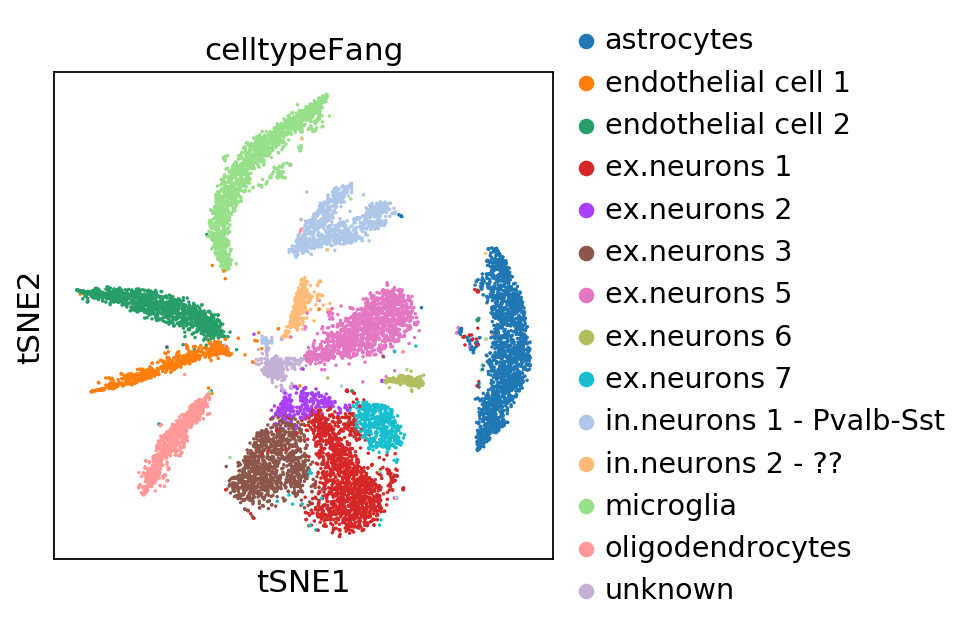

In [35]:
annot = []
for n in adata_Fang.obs['louvainFang_celltype2']:
    if n in ['5,0', '5,2', '5,3', '6']:
        annot.append('ex.neurons 1')
    elif n in ['5,1', '14']:
        annot.append('ex.neurons 2')
    elif n in ['1']:
        annot.append('ex.neurons 3')
    elif n in ['12, 5,3']:
        annot.append('ex.neurons 4')
    elif n in ['0']:
        annot.append('ex.neurons 5')
    elif n in ['4']:
        annot.append('in.neurons 1 - Pvalb-Sst')
    elif n in ['13']:
        annot.append('in.neurons 2 - ??')
    elif n in ['7']:
        annot.append('microglia')
    elif n in ['10']:
        annot.append('endothelial cell 1')
    elif n in ['2']:
        annot.append('endothelial cell 2')
    elif n in ['16']:
        annot.append('ex.neurons 6')
    elif n in ['12']:
        annot.append('ex.neurons 7')
    elif n in ['8']:
        annot.append('oligodendrocytes')
    elif n in ['3']:
        annot.append('astrocytes')
    else:
        annot.append(n)
        
adata_Fang.obs['celltypeFang'] = annot
sc.pl.umap(adata_Fang, wspace=0.5, color=['celltypeFang'])
sc.pl.tsne(adata_Fang, wspace=0.5, color=['celltypeFang'])

### adata_Cus

In [36]:
adata_Cus

View of AnnData object with n_obs × n_vars = 3380 × 35196 
    obs: 'batch', 'batchname', 'n_counts', 'n_windows', 'sum_peaks', 'n_genes'
    var: 'chrom-0-0', 'chrom2-0-0', 'n_cells-0-0', 'var_cells-0-0', 'overlap_3datasets', 'n_cells-1-0', 'var_cells-1-0', 'overlap10x-1-0', 'first_filtering-1', 'second_filtering-1', 'n_cells-1', 'var_cells-1', 'n_cells', 'var_cells', 'commonness'
    uns: 'batchname_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [37]:
sc.pp.pca(adata_Cus)
sc.pp.neighbors(adata_Cus, method='gauss')
sc.tl.umap(adata_Cus)
sc.tl.tsne(adata_Cus)

In [38]:
sc.tl.louvain(adata_Cus, resolution=1, key_added='louvainCus')

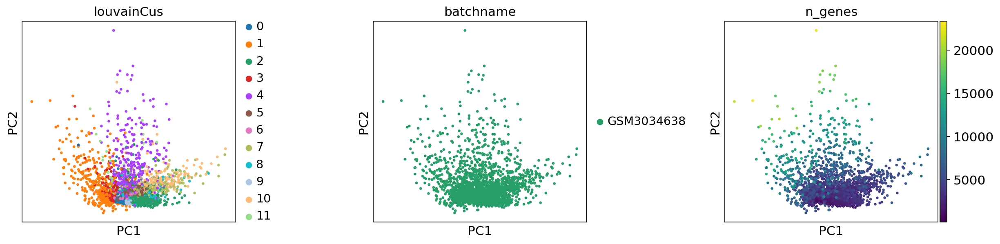

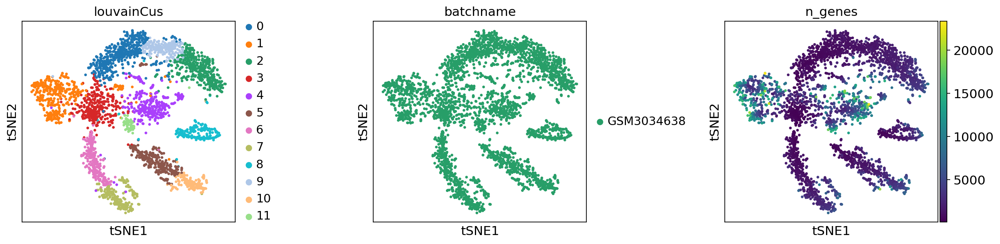

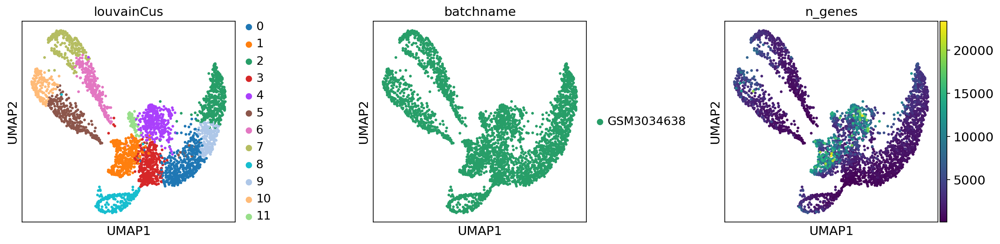

In [39]:
sc.pl.pca(adata_Cus, wspace=0.5, color=['louvainCus', 'batchname', 'n_genes'])
sc.pl.tsne(adata_Cus, wspace=0.5, color=['louvainCus', 'batchname', 'n_genes'])
sc.pl.umap(adata_Cus, wspace=0.5, color=['louvainCus', 'batchname', 'n_genes'])

In [40]:
annot = []
for n in adata_Cus.obs['louvainCus']:
    if n in ['10', '5']:
        annot.append('5')
    elif n in ['6', '7']:
        annot.append('6')
    elif n in ['0', '9', '2']:
        annot.append('0')
    else:
        annot.append(n)
adata_Cus.obs['louvainCus2']= annot

... storing 'louvainCus2' as categorical


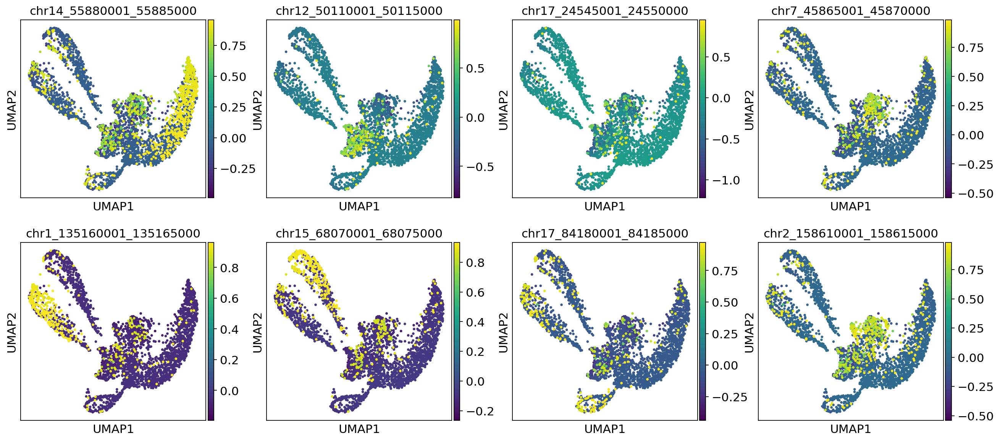

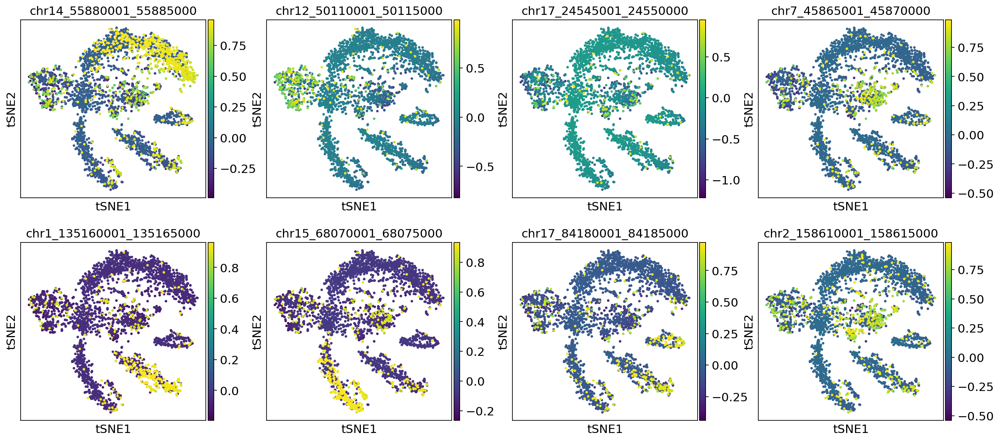

In [41]:
sc.tl.rank_genes_groups(adata_Cus, 'louvainCus2')
top_windows = adata_Cus.uns['rank_genes_groups']['names'][0].tolist()
sc.pl.umap(adata_Cus, color=top_windows)
sc.pl.tsne(adata_Cus, color=top_windows)

In [42]:
marker = top_windows[1]
print(marker)

chr12_50110001_50115000


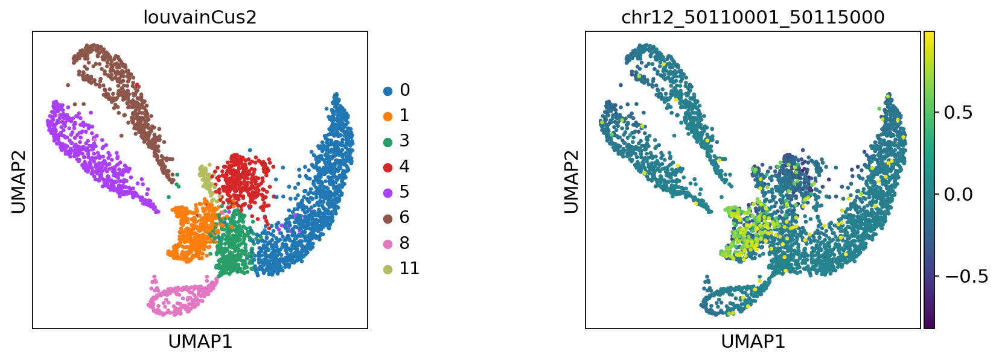

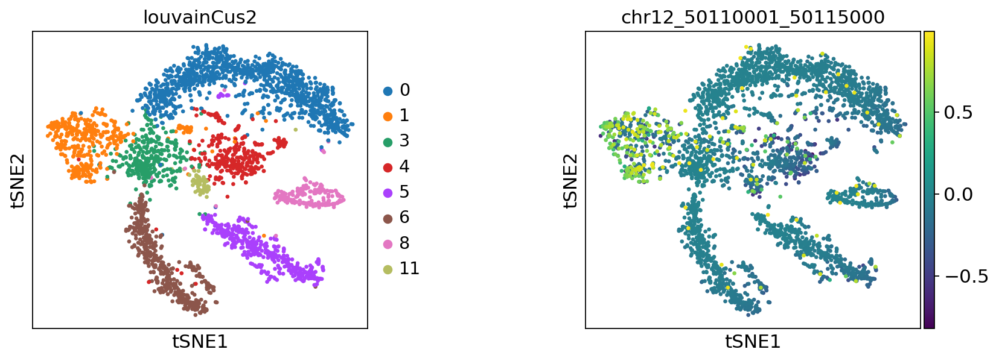

In [43]:
sc.pl.umap(adata_Cus, wspace=0.5, color=['louvainCus2', marker])
sc.pl.tsne(adata_Cus, wspace=0.5, color=['louvainCus2', marker])

In [44]:
# Zfat - cluster 6  - pyramidal cells in the hippocampal CA1 region and the Purkinje cells in the cerebellum
# + erytropois

In [45]:
annot = []
for n in adata_Cus.obs['louvainCus2']:
    if n in ['3']:
        annot.append('ex.neurons L5-L6 SCPN !')
        
    elif n in ['0']:
        annot.append('Cerebellar granular cells ?')
        
    elif n in ['1']:
        annot.append('ex.neurons L2-3-4 CPN ?')
    elif n in ['4']:
        annot.append('ex.neurons L6 CThPN?')
    elif n in ['5']:
        annot.append('endothelial cells?')
    elif n in ['6']:
        annot.append('microglia?')
    elif n in ['8']:
        annot.append('astrocytes !')
    elif n in ['11']:
        annot.append('in.neurons')
    
adata_Cus.obs['Cus_cellnames'] = annot

In [46]:
annot = []
for n in adata_Cus.obs['louvainCus2']:
    if n in ['3']:
        annot.append('ex.neurons L5-L6 SCPN')
        
    elif n in ['0']:
        annot.append('Cerebellar granular cells')
        
    elif n in ['1']:
        annot.append('ex.neurons L2-3-4 CPN')
    elif n in ['4']:
        annot.append('ex.neurons L6 CThPN')
    elif n in ['5']:
        annot.append('endothelial cells')
    elif n in ['6']:
        annot.append('microglia')
    elif n in ['8']:
        annot.append('astrocytes')
    elif n in ['11']:
        annot.append('in.neurons')
    
adata_Cus.obs['Cus_cellnames'] = annot

... storing 'Cus_cellnames' as categorical


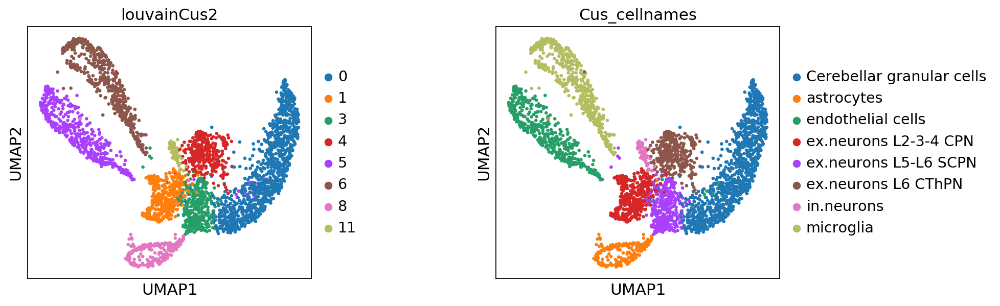

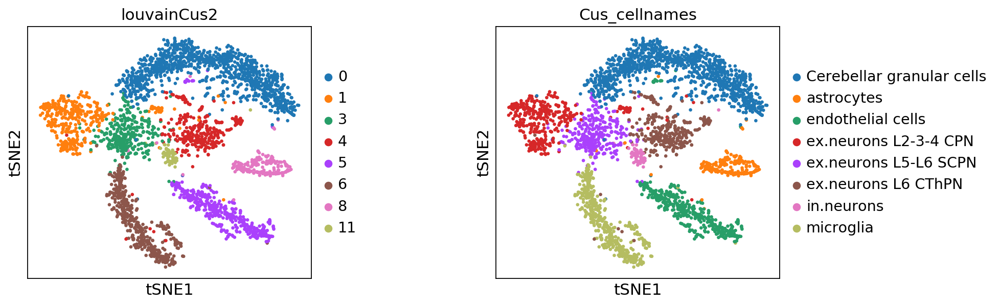

In [47]:
sc.pl.umap(adata_Cus, wspace=0.5, color=['louvainCus2', 'Cus_cellnames'])
sc.pl.tsne(adata_Cus, wspace=0.5, color=['louvainCus2', 'Cus_cellnames'])

# Overview of the cell types

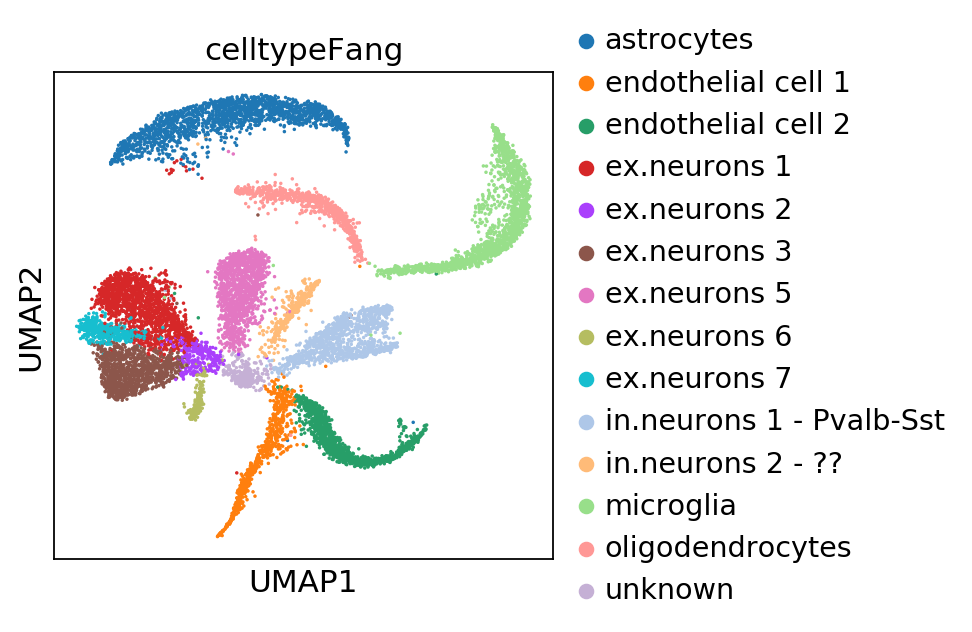

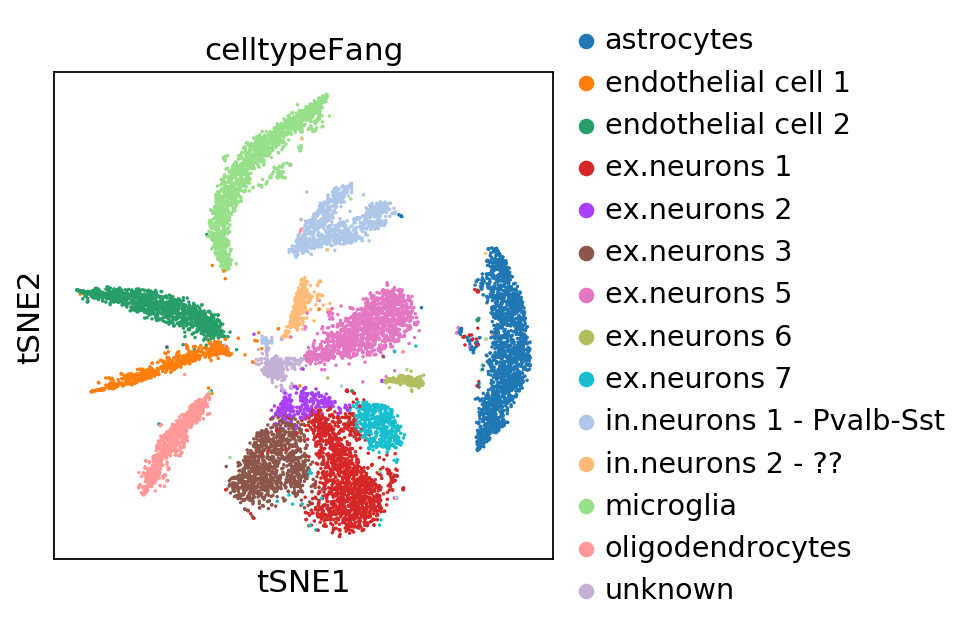

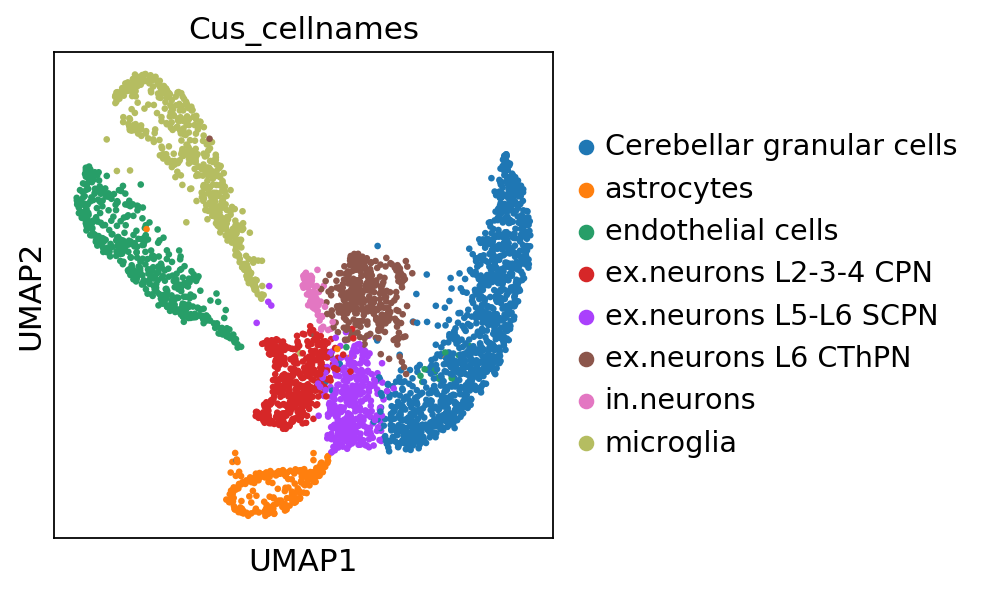

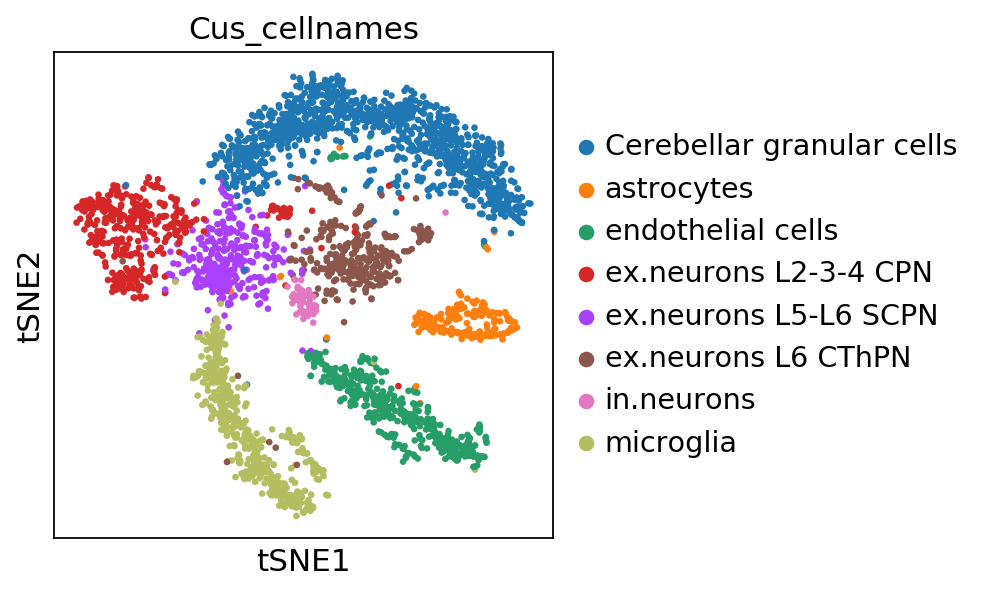

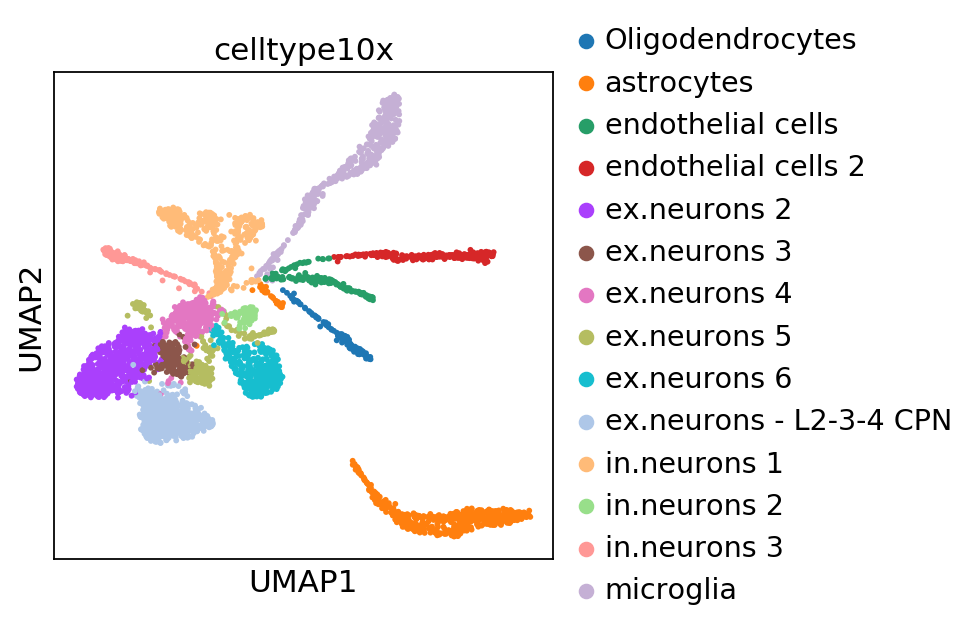

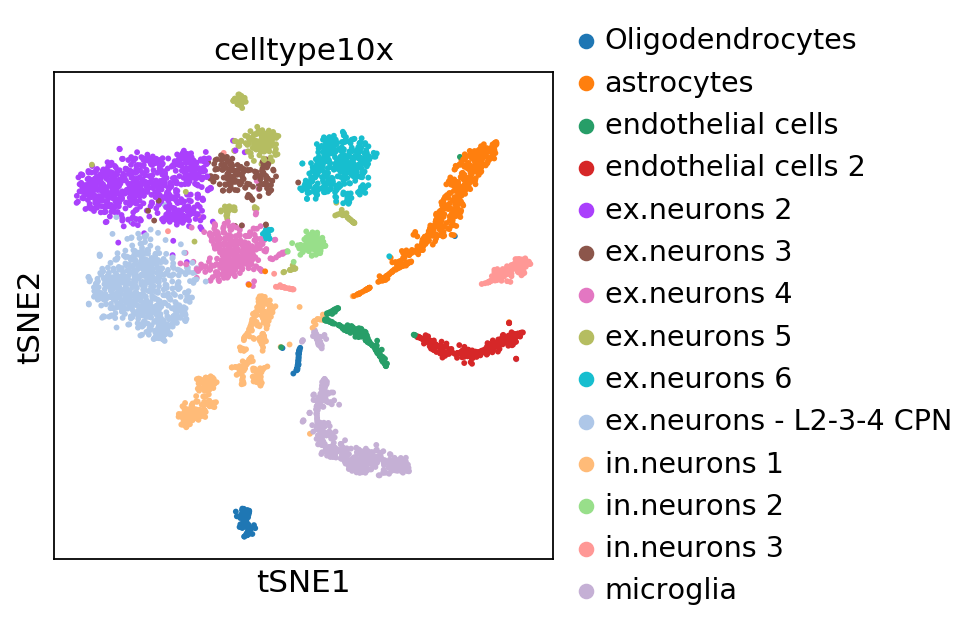

In [48]:
sc.pl.umap(adata_Fang, wspace=0.5, color=['celltypeFang'])
sc.pl.tsne(adata_Fang, wspace=0.5, color=['celltypeFang'])
sc.pl.umap(adata_Cus, wspace=0.5, color=['Cus_cellnames'])
sc.pl.tsne(adata_Cus, wspace=0.5, color=['Cus_cellnames'])
sc.pl.umap(adata_10x, wspace=0.5, color=['celltype10x'])
sc.pl.tsne(adata_10x, wspace=0.5, color=['celltype10x'])

## Trying to refine cell types

In [49]:
# Satb2 is a marker of upper layer Chromosome 1: 56,793,981-56,978,650
potential=[]
for n in adata_Fang.var_names.tolist():
    if 'chr1' in n:
        n = n.split('_')
        if len(n[1]) == 8 and n[1][:2] == '56':
            potential.append(n)

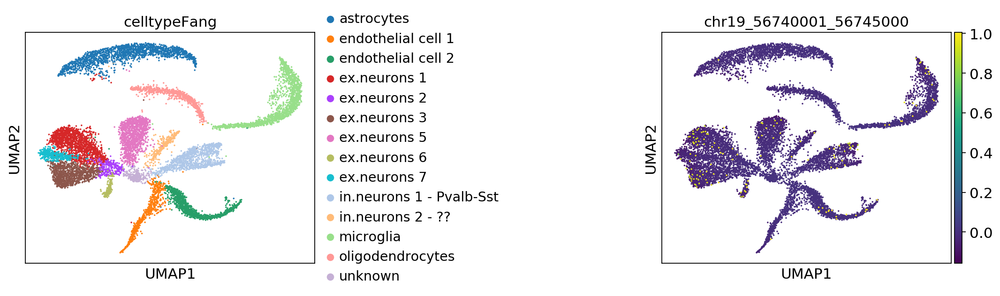

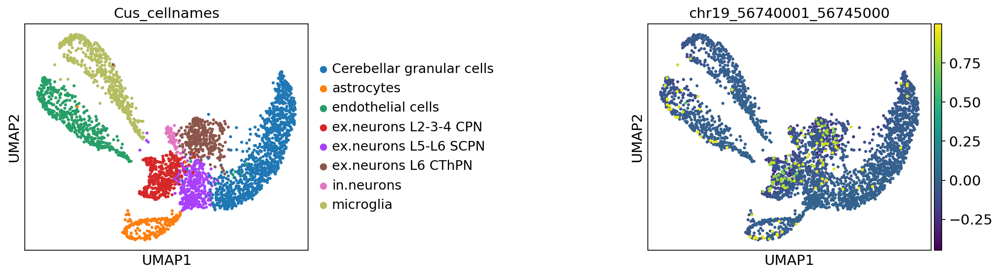

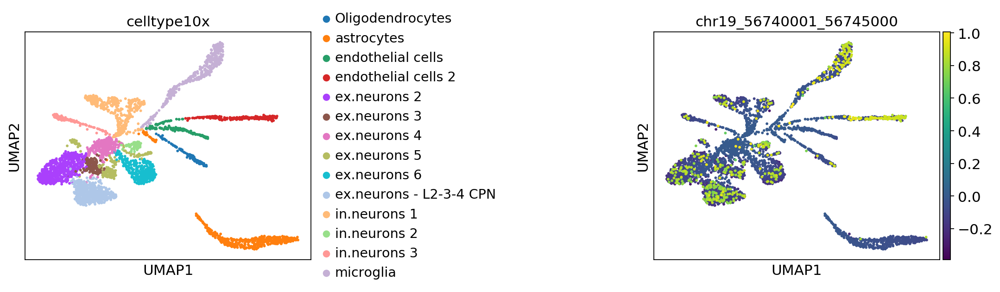

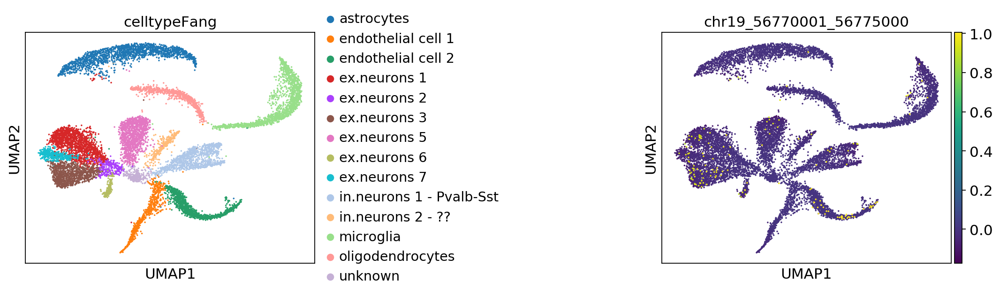

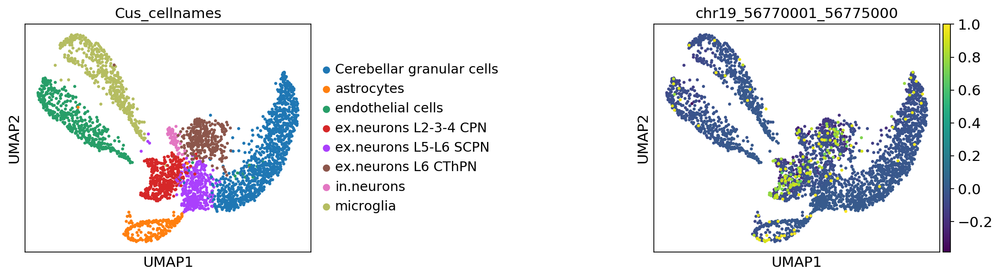

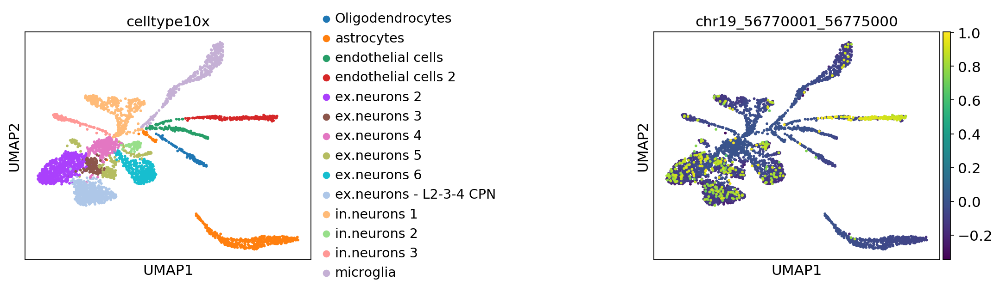

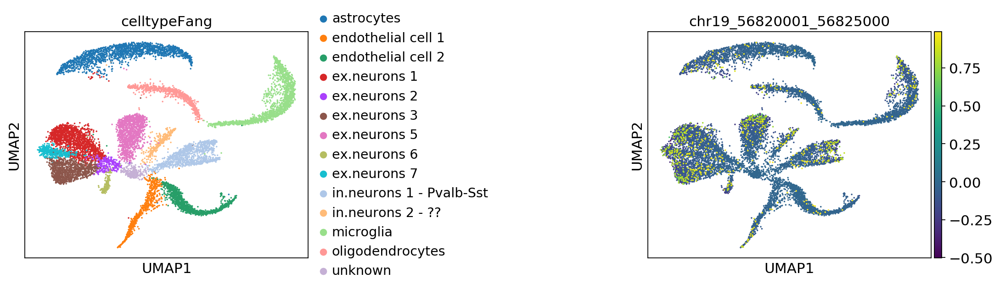

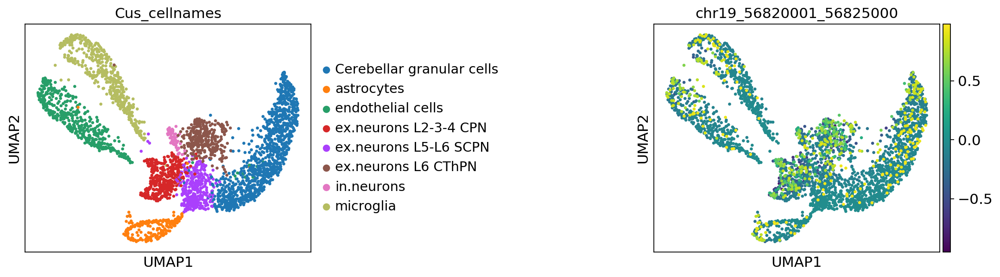

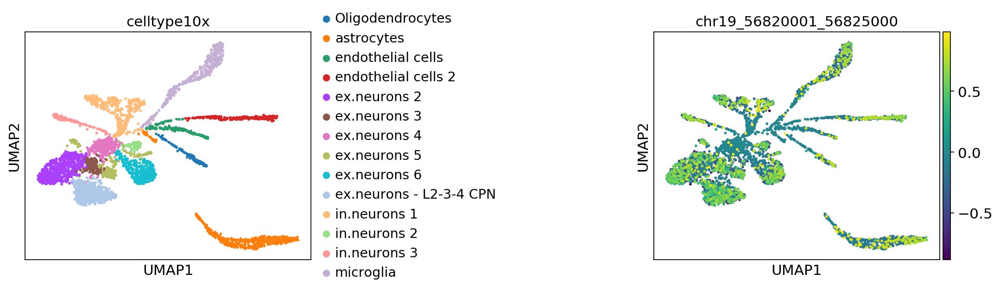

In [50]:
markers = [['chr19', '56740001', '56745000'],
 ['chr19', '56770001', '56775000'],
 ['chr19', '56820001', '56825000'],
]
for n in markers:
    n = '_'.join(n)
    sc.pl.umap(adata_Fang, wspace=1, color=['celltypeFang', n])
    sc.pl.umap(adata_Cus, wspace=1, color=['Cus_cellnames', n])
    sc.pl.umap(adata_10x, wspace=1, color=['celltype10x', n])


## transposing annot to the merged dataset

In [51]:
adata_merge_all

AnnData object with n_obs × n_vars = 19811 × 35196 
    obs: 'batch', 'batchname', 'n_counts', 'n_windows', 'sum_peaks', 'n_genes'
    var: 'chrom-0-0', 'chrom2-0-0', 'n_cells-0-0', 'var_cells-0-0', 'overlap_3datasets', 'n_cells-1-0', 'var_cells-1-0', 'overlap10x-1-0', 'first_filtering-1', 'second_filtering-1', 'n_cells-1', 'var_cells-1', 'n_cells', 'var_cells', 'commonness'
    uns: 'batchname_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'

In [52]:
set(adata_merge_all.obs['batchname'])

{'10x Genomics', 'Fang et al. 2019', 'GSM3034638'}

In [53]:
annot10x = adata_10x.obs['celltype10x'].tolist()+len(adata_Fang.obs_names)*['NA']+len(adata_Cus.obs_names)*['NA']

len(annot10x)


19811

In [54]:
annotFang = len(adata_10x.obs['celltype10x'])*['NA']+adata_Fang.obs['celltypeFang'].tolist()+len(adata_Cus.obs['Cus_cellnames'])*['NA']

len(annotFang)


19811

In [55]:
annotCus = len(adata_10x.obs['celltype10x'])*['NA']+len(adata_Fang.obs['celltypeFang'])*['NA']+ adata_Cus.obs['Cus_cellnames'].tolist()

len(annotCus)


19811

In [56]:
annot_tot = [''.join(['10x-', n]) for n in adata_10x.obs['celltype10x'].tolist()]+[''.join(['Fang-', n]) for n in adata_Fang.obs['celltypeFang'].tolist()]+[''.join(['Cus-', n]) for n in adata_Cus.obs['Cus_cellnames'].tolist()]

len(annot_tot)


19811

In [57]:
adata_merge_all.obs['cell_type_10x'] = annot10x
adata_merge_all.obs['cell_type_Fang'] = annotFang
adata_merge_all.obs['cell_type_GSM3034638'] = annotCus
adata_merge_all.obs['cell_type_all'] = annot_tot

... storing 'cell_type_10x' as categorical
... storing 'cell_type_Fang' as categorical
... storing 'cell_type_GSM3034638' as categorical
... storing 'cell_type_all' as categorical


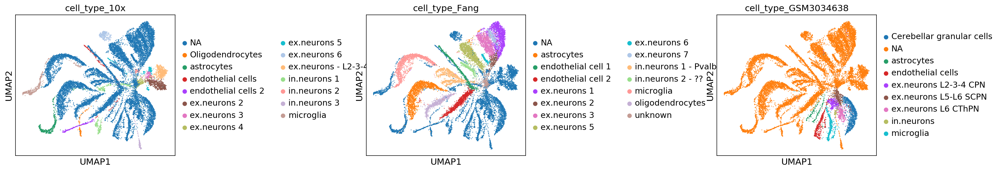

In [58]:
fplot="_brain_atac_3datasets_min100windows_top_var_feat_regression_cell_types.pdf"
sc.pl.umap(adata_merge_all, wspace=1, color=['cell_type_10x', 'cell_type_Fang', 'cell_type_GSM3034638'],save=fplot)

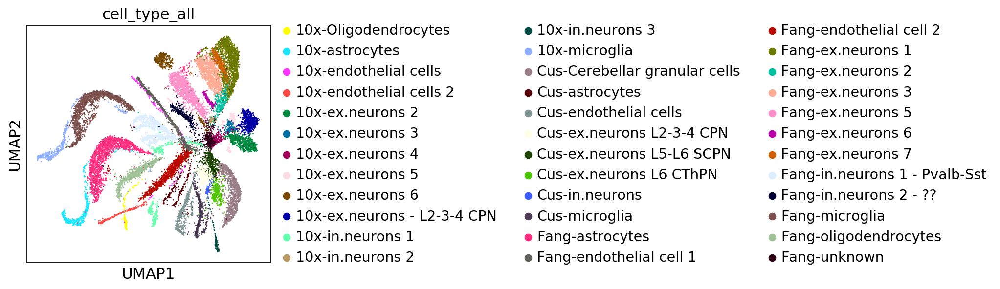

In [59]:
sc.pl.umap(adata_merge_all, wspace=1, color='cell_type_all')

... storing 'cell_type_consensus' as categorical


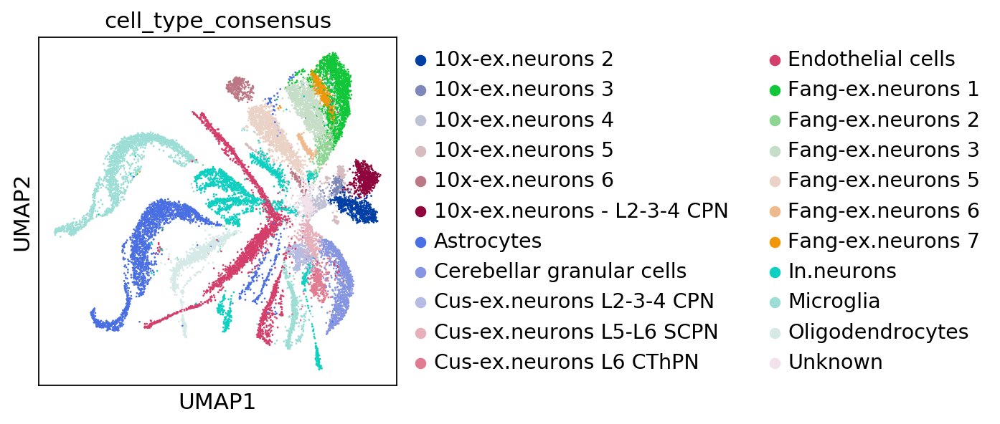

In [61]:
consensus = []
for n in adata_merge_all.obs['cell_type_all']:
    if n in ['10x-Oligodendrocytes', 'Fang-oligodendrocytes']:
        consensus.append('Oligodendrocytes')
    elif n in ['Fang-endothelial cell 1', 'Fang-endothelial cell 2',
               '10x-endothelial cells', '10x-endothelial cells 2', 'Cus-endothelial cells']:
        consensus.append('Endothelial cells')
    elif n in ['Cus-in.neurons', 'Fang-in.neurons 1 - Pvalb-Sst', 'Fang-in.neurons 2 - ??',
              '10x-in.neurons 1', '10x-in.neurons 2', '10x-in.neurons 3']:
        consensus.append('In.neurons')
    elif n in ['Cus-microglia', 'Fang-microglia', '10x-microglia']:
        consensus.append('Microglia')
        
        
    elif n in ['Fang-astrocytes', 'Cus-astrocytes', '10x-astrocytes']:
        consensus.append('Astrocytes')
    
    elif n in ['Cus-Cerebellar granular cells']:
        consensus.append('Cerebellar granular cells')
    
    elif n in ['Fang-unknown']:
        consensus.append('Unknown')
    else:
        consensus.append(n)
        
adata_merge_all.obs['cell_type_consensus'] = consensus
sc.pl.umap(adata_merge_all, wspace=1, color='cell_type_consensus')

... storing 'cell_type_consensus' as categorical


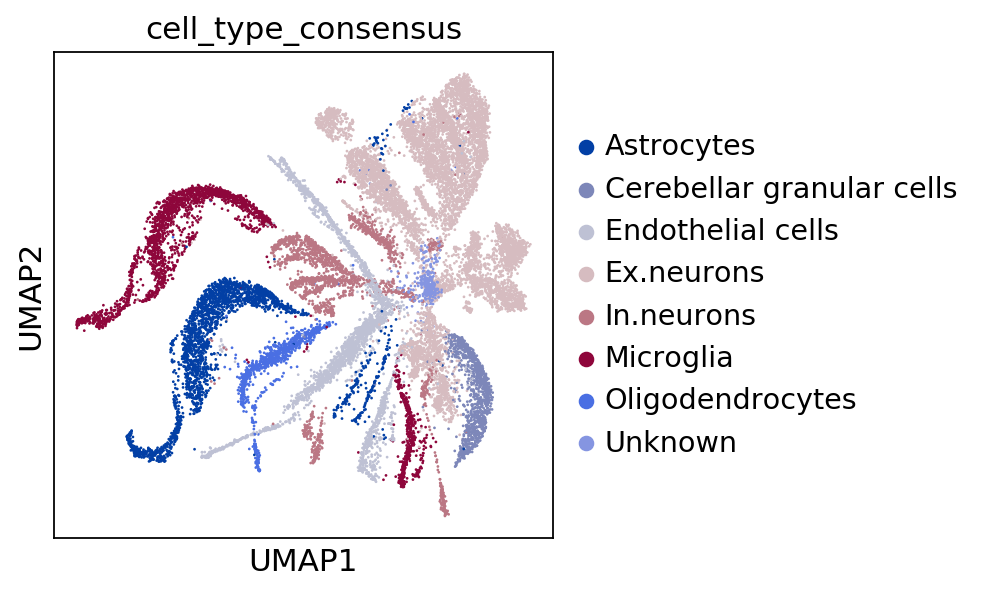

In [62]:
consensus = []
for n in adata_merge_all.obs['cell_type_all']:
    if n in ['10x-Oligodendrocytes', 'Fang-oligodendrocytes']:
        consensus.append('Oligodendrocytes')
    elif n in ['Fang-endothelial cell 1', 'Fang-endothelial cell 2',
               '10x-endothelial cells', '10x-endothelial cells 2', 'Cus-endothelial cells']:
        consensus.append('Endothelial cells')
    elif n in ['Cus-in.neurons', 'Fang-in.neurons 1 - Pvalb-Sst', 'Fang-in.neurons 2 - ??',
              '10x-in.neurons 1', '10x-in.neurons 2', '10x-in.neurons 3']:
        consensus.append('In.neurons')
    elif n in ['Cus-microglia', 'Fang-microglia', '10x-microglia']:
        consensus.append('Microglia')
        
        
    elif n in ['Fang-astrocytes', 'Cus-astrocytes', '10x-astrocytes']:
        consensus.append('Astrocytes')
    
    elif n in ['Cus-Cerebellar granular cells']:
        consensus.append('Cerebellar granular cells')
    
    elif n in ['Fang-unknown']:
        consensus.append('Unknown')
    else:
        consensus.append('Ex.neurons')
        
adata_merge_all.obs['cell_type_consensus'] = consensus
sc.pl.umap(adata_merge_all, wspace=1, color='cell_type_consensus')

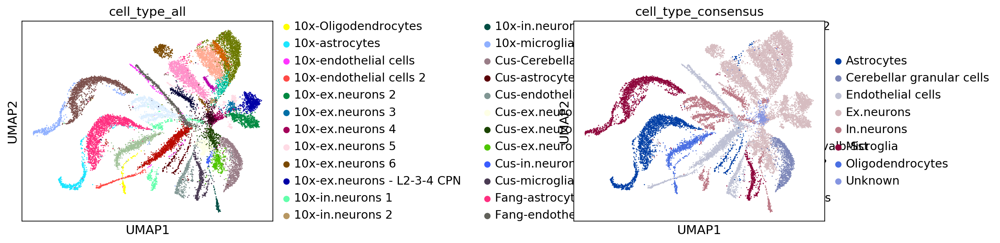

In [63]:
fplot="_brain_atac_3datasets_min100windows_top_var_feat_regression_cell_types_2.pdf"
sc.pl.umap(adata_merge_all, wspace=1, color=['cell_type_all', 'cell_type_consensus'],save=fplot)

## IMPORTANT

 - I might have misslabeled microglia and endothelial cells

In [64]:
# uncomment this line to save the file
adata_merge_all.write(DATADIR+"/merge_10x_CEMBA180312_3B_GSM3034638_bin_merged_top_var_feat_min100cells_regression_cell_labels.h5ad")

# uncomment this line to save the file
adata_merge_all.X = scipy.sparse.csr_matrix(adata_merge_all.X)
adata_merge_all.write(DATADIR+"/merge_10x_CEMBA180312_3B_GSM3034638_bin_merged_top_var_feat_min100cells_regression_Seurat_cell_labels.h5ad")

In [65]:
adata_merge_all500 = adata_merge_all[adata_merge_all.obs['n_windows']>500,:]
adata_merge_all500

sc.pp.pca(adata_merge_all500)
sc.pp.neighbors(adata_merge_all500, method='gauss')
sc.tl.tsne(adata_merge_all500)
sc.tl.umap(adata_merge_all500)

The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../../../../home/icb/chaichoompu/.local/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^



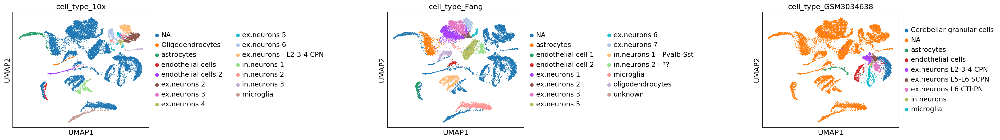

In [71]:
fplot="_brain_atac_3datasets_min500windows_top_var_feat_regression_cell_types.pdf"
sc.pl.umap(adata_merge_all500, wspace=1.5, color=['cell_type_10x', 'cell_type_Fang', 'cell_type_GSM3034638'],save=fplot)

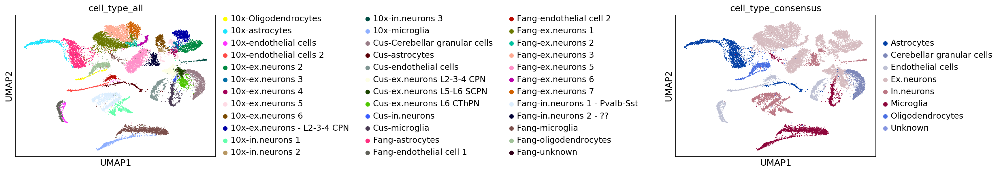

In [73]:
fplot="_brain_atac_3datasets_min500windows_top_var_feat_regression_cell_types_2.pdf"
sc.pl.umap(adata_merge_all500, wspace=2, color=['cell_type_all', 'cell_type_consensus'],save=fplot)

In [68]:
# uncomment this line to save the file
adata_merge_all500.write(DATADIR+"/merge_10x_CEMBA180312_3B_GSM3034638_bin_merged_top_var_feat_min500cells_regression_cell_labels.h5ad")

# uncomment this line to save the file
adata_merge_all500.X = scipy.sparse.csr_matrix(adata_merge_all500.X)
adata_merge_all500.write(DATADIR+"/merge_10x_CEMBA180312_3B_GSM3034638_bin_merged_top_var_feat_min500cells_regression_Seurat_cell_labels.h5ad")